In [88]:
import matplotlib.pyplot as plt
from imp import reload
from typing import List
import os
import pickle
import pandas as pd
import numpy as np
import sys
from skimage.transform import resize

sys.path.insert(1, os.path.join(sys.path[0], '..'))
from data_utils import DataHandler
import evaluate
import histogram_processing
import detect_textbox
import similarities
import bg_masks
import image_utils
import image_features
import text_retrieval

N_PROCESS = 10

# Load Data

In [89]:
data_handler = DataHandler()

# Load images:
db, db_files = data_handler.load_images(folder = "../data/BBDD/", extension = ".jpg", desc = "Loading BBDD Data...")
qsd1_w2, qsd1_w2_files = data_handler.load_images(folder = "../data/qsd1_w2/", extension = ".jpg", desc = "Loading qsd1_w2 Data...")
qsd1_w3, qsd1_w3_files = data_handler.load_images(folder = "../data/qsd1_w3/", extension = ".jpg", desc = "Loading qsd1_w3 Data...")
qsd2_w3, qsd2_w3_files = data_handler.load_images(folder = "../data/qsd2_w3/", extension = ".jpg", desc = "Loading qsd2_w3 Data...")

# Load text:
db_text = data_handler.load_text(folder = "../data/BBDD/", extension = ".txt", desc = "Loading BBDD Text data...")
qsd1_w2_text = data_handler.load_text(folder = "../data/qsd1_w2/", extension = ".txt", desc = "Loading qsd1_w2 Text data...")
qsd1_w3_text = data_handler.load_text(folder = "../data/qsd1_w3/", extension = ".txt", desc = "Loading qsd1_w3 Text data...")
qsd2_w3_text = data_handler.load_text_multiple(folder = "../data/qsd2_w3/", extension = ".txt", desc = "Loading qsd2_w3 Text data...")

Initialized DataHandler with 2 processes


Loading BBDD Data...:  47%|████▋     | 136/287 [00:03<00:03, 41.17it/s]/Users/johnny/miniconda3/envs/Team1/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:702: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
Loading BBDD Data...: 100%|██████████| 287/287 [00:07<00:00, 38.81it/s]


../data/BBDD/ read: 287 images


Loading qsd1_w2 Data...: 100%|██████████| 30/30 [00:00<00:00, 338.93it/s]


../data/qsd1_w2/ read: 30 images


Loading qsd1_w3 Data...: 100%|██████████| 30/30 [00:00<00:00, 576.59it/s]


../data/qsd1_w3/ read: 30 images


Loading qsd2_w3 Data...: 100%|██████████| 30/30 [00:00<00:00, 95.90it/s] 


../data/qsd2_w3/ read: 30 images


Loading BBDD Text data...: 100%|██████████| 287/287 [00:00<00:00, 12595.38it/s]


../data/BBDD/ read: 287 images


Loading qsd1_w2 Text data...: 100%|██████████| 30/30 [00:00<00:00, 7783.57it/s]


../data/qsd1_w2/ read: 30 images


Loading qsd1_w3 Text data...: 100%|██████████| 30/30 [00:00<00:00, 7472.04it/s]


../data/qsd1_w3/ read: 30 images


Loading qsd2_w3 Text data...: 100%|██████████| 30/30 [00:00<00:00, 7568.21it/s]


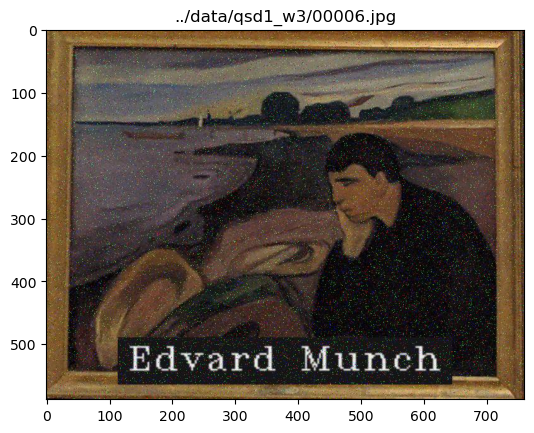

In [90]:
for i, (img, filename) in enumerate(zip(qsd1_w3, qsd1_w3_files)):
    plt.imshow(img)
    plt.title(filename)
    if i > 5:
        break

In [91]:
from skimage.io import imread

def plot_image_and_similar(qs, top_k_qs) -> None:

    for i in range(min(5, len(qs))):
        f, axarr = plt.subplots(1, 2, figsize=(10, 10))
        query = qs[i]
        res = imread(top_k_qs[i][0])
        axarr[0].imshow(query)
        axarr[0].title.set_text("Query")
        axarr[1].imshow(res)
        axarr[1].title.set_text("Result")
        plt.show()

def plot_image_and_similars(db, qs, top_k_qs) -> None:

    for i in range(min(5, len(qs))):
        f, axarr = plt.subplots(1, 4, figsize=(10, 10))
        axarr[0].imshow(qs[i])
        res_0 = top_k_qs[i][0]
        res_1 = top_k_qs[i][1]
        res_2 = top_k_qs[i][2]
        axarr[1].imshow(db[int(res_0[-9:-4])])
        axarr[2].imshow(db[int(res_1[-9:-4])])
        axarr[3].imshow(db[int(res_2[-9:-4])])
        plt.show()
        
def plot_image_and_similar_painter(db, db_text, qs, qs_text, top_k_qs) -> None:

    for i in range(min(4, len(qs))):
        f, axarr = plt.subplots(1, 4, figsize=(10, 10))
        axarr[0].imshow(qs[i])
        axarr[0].title.set_text(qs_text[i][0])
        res_0 = top_k_qs[i][0]
        res_1 = top_k_qs[i][1]
        res_2 = top_k_qs[i][2]
        axarr[1].imshow(db[res_0])
        axarr[1].title.set_text(db_text[res_0][0])
        axarr[2].imshow(db[res_1])
        axarr[2].title.set_text(db_text[res_1][0])
        axarr[3].imshow(db[res_2])
        axarr[3].title.set_text(db_text[res_2][0])
        plt.show()
        
def plot_image_and_similar_painting(db, db_text, qs, qs_text, top_k_qs) -> None:

    for i in range(min(4, len(qs))):
        f, axarr = plt.subplots(1, 4, figsize=(10, 10))
        axarr[0].imshow(qs[i])
        axarr[0].title.set_text(qs_text[i][1])
        res_0 = top_k_qs[i][0]
        res_1 = top_k_qs[i][1]
        res_2 = top_k_qs[i][2]
        axarr[1].imshow(db[res_0])
        axarr[1].title.set_text(db_text[res_0][1])
        axarr[2].imshow(db[res_1])
        axarr[2].title.set_text(db_text[res_1][1])
        axarr[3].imshow(db[res_2])
        axarr[3].title.set_text(db_text[res_2][1])
        plt.show()


## Task 2

In [92]:
pred_texts_greys_qsd1_w2_folder = './results/text/pred_texts_greys_qsd1_w2/'
pred_texts_greys_qsd1_w2 = data_handler.load_text(folder = pred_texts_greys_qsd1_w2_folder, extension = ".txt", desc = "Loading Predicted Text data...", tuples=False)
top_3_text_multiple_qsd1_w2 = text_retrieval.get_top_k_text_multiple(pred_texts_greys_qsd1_w2, db_text, k=3, dist = 'damerau_levenshtein')

Loading Predicted Text data...: 100%|██████████| 30/30 [00:00<00:00, 99.42it/s]


./results/text/pred_texts_greys_qsd1_w2/ read: 30 images


Retrieving top 3 results from Text using DAMERAU_LEVENSHTEIN distance: 100%|██████████| 30/30 [00:01<00:00, 15.81it/s]


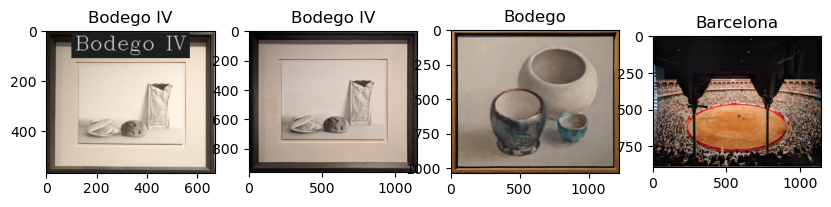

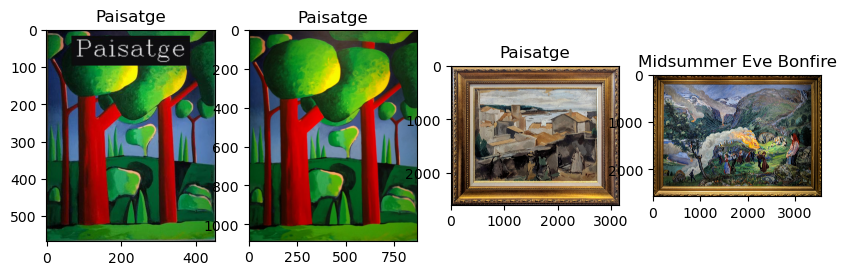

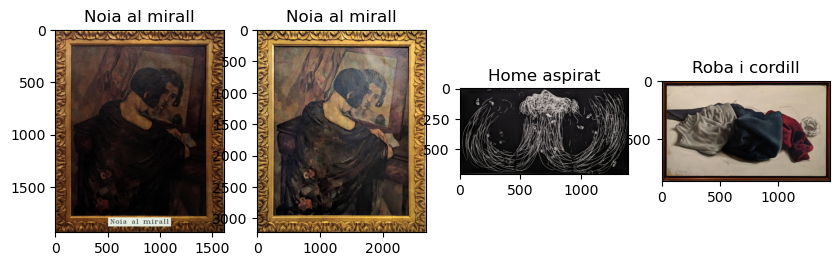

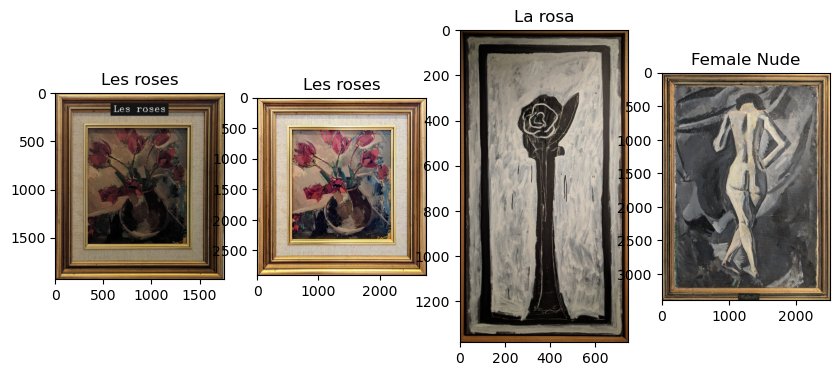

In [93]:
plot_image_and_similar_painting(db, db_text, qsd1_w2, qsd1_w2_text, top_3_text_multiple_qsd1_w2)

## Task 3

### HoG

In [94]:
db_texture_matrix = image_features.hog_batch(images = db[:], mssg="Histograms of Gradients (HoG) from BBDD...")
qsd1_w2_texture_matrix = image_features.hog_batch(images = qsd1_w2[:], mssg="Histograms of Gradients (HoG) from qsd1_w2...")

Histograms of Gradients (HoG) from qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 93.04it/s] 


In [95]:
print (f'We have {qsd1_w2_texture_matrix.shape[0]} images, each with a {qsd1_w2_texture_matrix.shape[1]} dimensional descriptor')

We have 30 images, each with a 300 dimensional descriptor


/var/folders/pv/m0d2tn25285cc_5x46fswyjr0000gn/T/ipykernel_27747/3443643721.py:4: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  i = list(qsd1_w2).index(im)


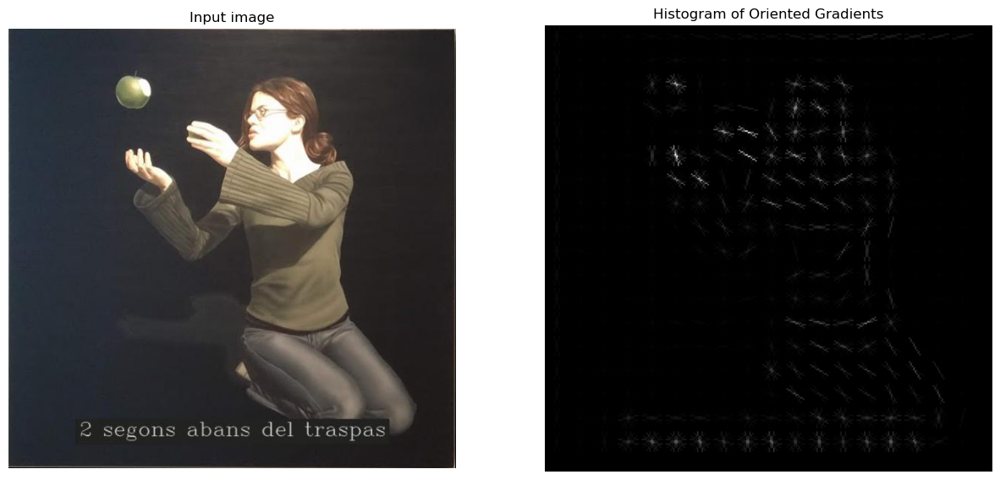

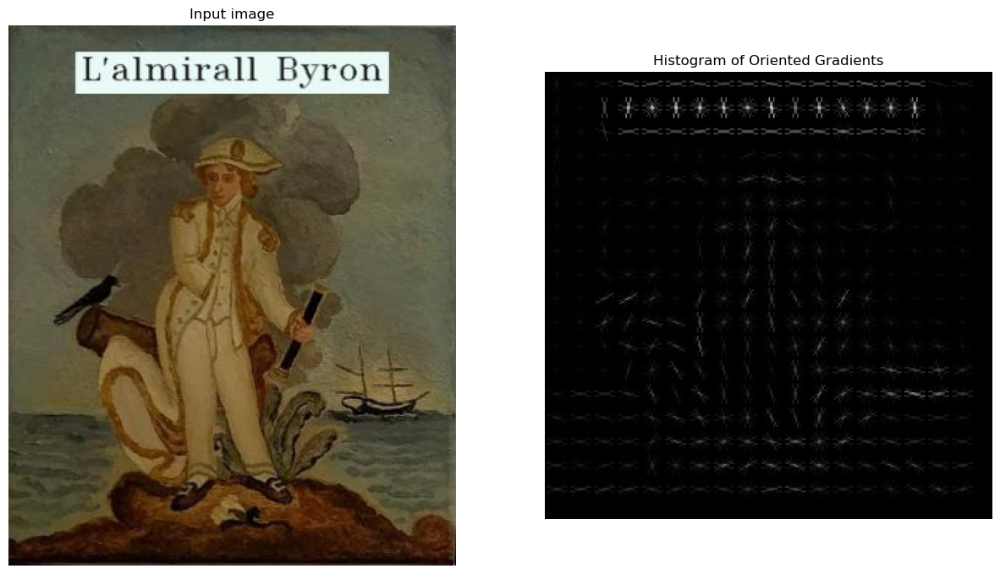

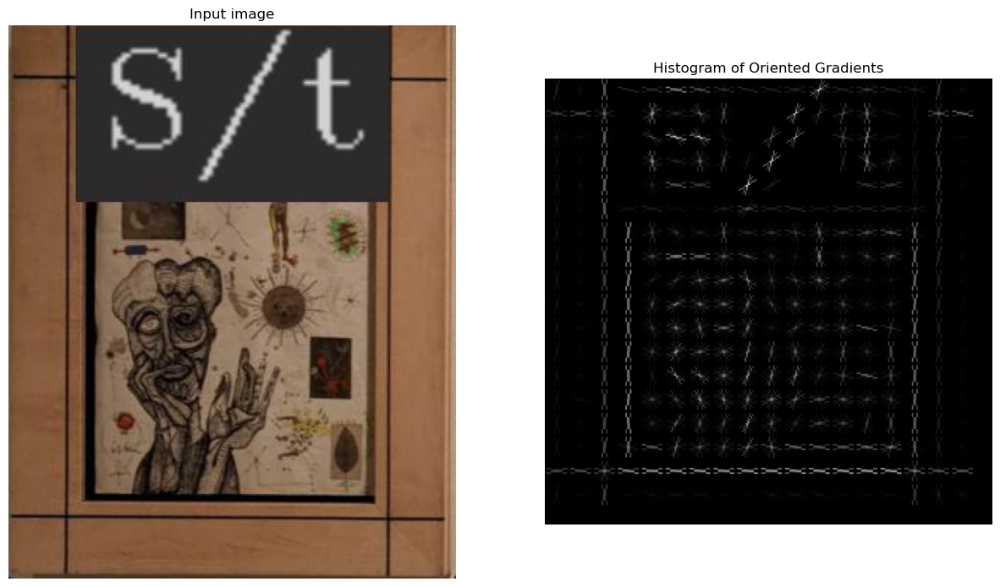

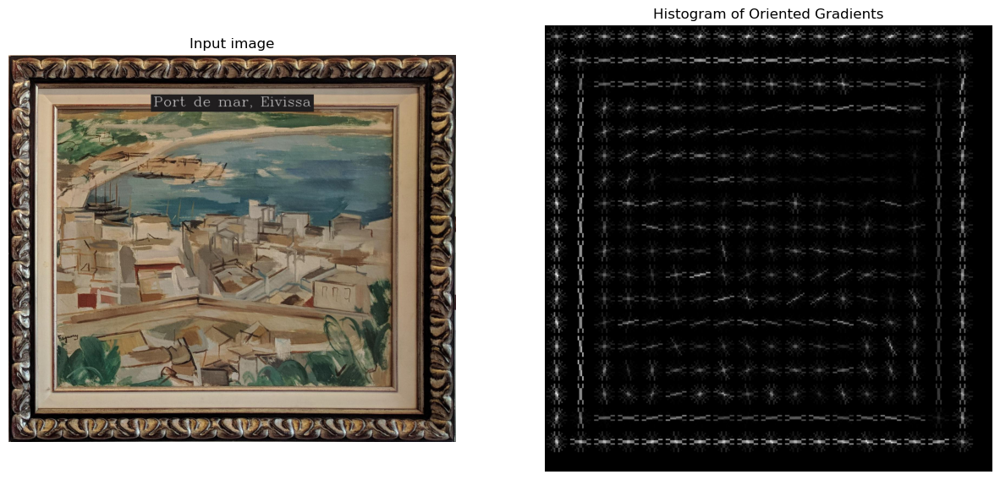

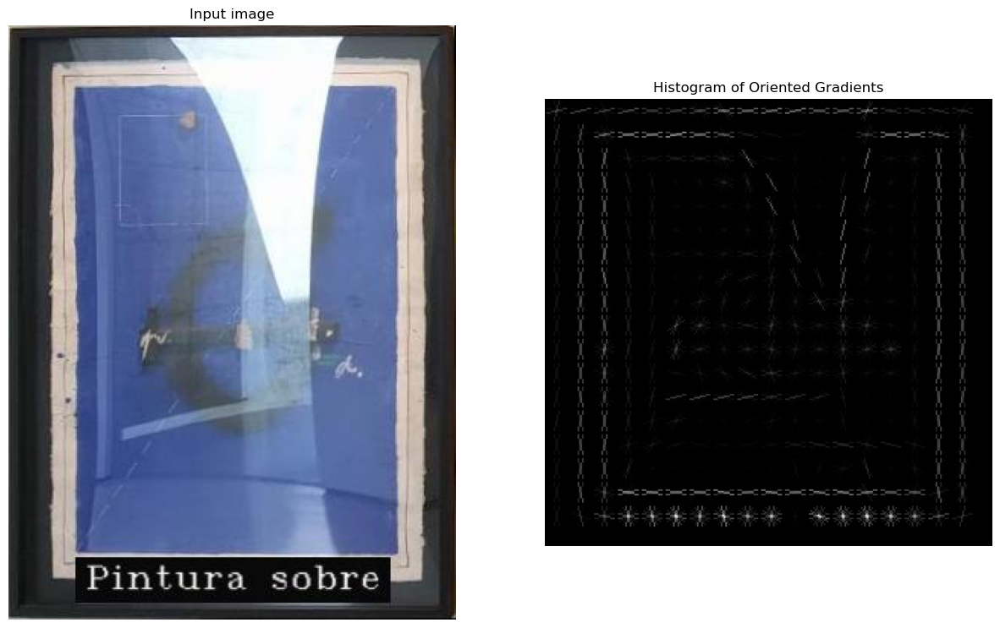

In [96]:
from skimage.exposure import rescale_intensity

for im in qsd1_w2[4:9]:
    i = list(qsd1_w2).index(im)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 15))
    ax1.axis('off')
    ax1.imshow(im, cmap=plt.cm.gray)
    ax1.set_title('Input image')

    hog_image_rescaled = rescale_intensity(qsd1_w2_texture_matrix[i], in_range=(0, 10))

    ax2.axis('off')
    ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
    ax2.set_title('Histogram of Oriented Gradients')
    plt.show()

In [97]:
reload(similarities)
qsd1_w2_similarity_matrix = similarities.compute_similarities_parallel(
    qsd1_w2_texture_matrix, db_texture_matrix, similarities.measures["hellinger_kernel"], "Computing similarities for HoG...", N_PROCESS
)

Computing similarities for HoG...: 100%|██████████| 30/30 [00:02<00:00, 14.40it/s]


In [98]:
evaluate.get_mapk(
    similarity_matrix=qsd1_w2_similarity_matrix,
    db_files=db_files,
    query_dataset="qsd1_w2",
    data_handler=data_handler,
    out_dir="../results/data/w3/HoG/",
)

Retrieving top 1 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 34682.78it/s]


Results saved at ../results/data/w3/HoG//qsd1_w2.pkl/result.pkl
MAP@1 Score: 96.6667% (29/30)


Retrieving top 5 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 29676.68it/s]


Results saved at ../results/data/w3/HoG//qsd1_w2.pkl/result.pkl
MAP@5 Score: 98.3333% (29/30)


Retrieving top 10 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 30240.12it/s]


Results saved at ../results/data/w3/HoG//qsd1_w2.pkl/result.pkl
MAP@10 Score: 98.3333% (29/30)


[[1, 96.66666666666667, 29, 30],
 [5, 98.33333333333333, 29, 30],
 [10, 98.33333333333333, 29, 30]]

### DCT

#### No quantize + PCA

In [99]:
reload(image_features)
db_texture_matrix = image_features.dct_batch(images = db[:], quantize=False, mssg="DCT from BBDD...").reshape(len(db), -1)
qsd1_w2_texture_matrix = image_features.dct_batch(images = qsd1_w2[:], quantize=False, mssg="DCT from qsd1_w2...").reshape(len(qsd1_w2), -1)

DCT from qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 87.94it/s] 


In [100]:
print (f'We have {qsd1_w2_texture_matrix.reshape(30, -1).shape[0]} images, each with a {qsd1_w2_texture_matrix.reshape(30, -1).shape[1]} dimensional descriptor')

We have 30 images, each with a 270000 dimensional descriptor


In [101]:
db_texture_matrix.shape

(287, 270000)

In [102]:
import sklearn.decomposition
PCA_LBP = sklearn.decomposition.PCA(
    n_components=min(300, min(db_texture_matrix.shape[0], db_texture_matrix.shape[1])),
    random_state=1234,
)
db_texture_matrix_PCA = PCA_LBP.fit_transform(db_texture_matrix)
qsd1_w2_texture_matrix_PCA = PCA_LBP.transform(qsd1_w2_texture_matrix)

In [103]:
qsd1_w2_similarity_matrix = similarities.compute_similarities_parallel(
    qsd1_w2_texture_matrix_PCA, db_texture_matrix_PCA, similarities.measures["euclidean_distance"], "Computing similarities for DCT...", N_PROCESS
)

Computing similarities for DCT...: 100%|██████████| 30/30 [00:01<00:00, 16.17it/s]


In [104]:
evaluate.get_mapk(
    similarity_matrix=qsd1_w2_similarity_matrix,
    db_files=db_files,
    query_dataset="qsd1_w2",
    data_handler=data_handler,
    out_dir="../results/data/w3/DCT/",
)

Retrieving top 1 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 49991.70it/s]


Results saved at ../results/data/w3/DCT//qsd1_w2.pkl/result.pkl
MAP@1 Score: 70.0000% (21/30)


Retrieving top 5 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 29215.03it/s]


Results saved at ../results/data/w3/DCT//qsd1_w2.pkl/result.pkl
MAP@5 Score: 72.5000% (21/30)


Retrieving top 10 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 28143.40it/s]

Results saved at ../results/data/w3/DCT//qsd1_w2.pkl/result.pkl
MAP@10 Score: 72.5000% (21/30)


[[1, 70.0, 21, 30], [5, 72.5, 21, 30], [10, 72.5, 21, 30]]

#### Prune coeffs.

In [105]:
reload(image_features)
db_texture_matrix = image_features.dct_batch(images = db[:], quantize=True, mssg="DCT from BBDD...")
qsd1_w2_texture_matrix = image_features.dct_batch(images = qsd1_w2[:], quantize=True, mssg="DCT from qsd1_w2...")

DCT from BBDD...:  14%|█▍        | 40/287 [00:02<00:09, 26.52it/s]/Users/johnny/miniconda3/envs/Team1/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:702: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
DCT from qsd1_w2...: 100%|██████████| 30/30 [00:01<00:00, 22.99it/s]


In [106]:
print (f'We have {qsd1_w2_texture_matrix.shape[0]} images, each with a {qsd1_w2_texture_matrix.shape[1]} dimensional descriptor')

We have 30 images, each with a 4332 dimensional descriptor


In [107]:
reload(similarities)
qsd1_w2_similarity_matrix = similarities.compute_similarities_parallel(
    db_texture_matrix, qsd1_w2_texture_matrix, similarities.measures["l1_distance"], "Computing similarities for DCT...", N_PROCESS
)

Computing similarities for DCT...: 100%|██████████| 287/287 [00:01<00:00, 152.31it/s]


In [108]:
evaluate.get_mapk(
    similarity_matrix=qsd1_w2_similarity_matrix,
    db_files=db_files,
    query_dataset="qsd1_w2",
    data_handler=data_handler,
    out_dir="../results/data/w3/DCT/",
)

Retrieving top 1 similar images for qsd1_w2...: 100%|██████████| 287/287 [00:00<00:00, 109492.93it/s]


Results saved at ../results/data/w3/DCT//qsd1_w2.pkl/result.pkl
MAP@1 Score: 0.0000% (0/287)


Retrieving top 5 similar images for qsd1_w2...: 100%|██████████| 287/287 [00:00<00:00, 102317.49it/s]


Results saved at ../results/data/w3/DCT//qsd1_w2.pkl/result.pkl
MAP@5 Score: 0.0000% (0/287)


Retrieving top 10 similar images for qsd1_w2...: 100%|██████████| 287/287 [00:00<00:00, 73873.29it/s]

Results saved at ../results/data/w3/DCT//qsd1_w2.pkl/result.pkl
MAP@10 Score: 0.0000% (0/287)


[[1, 0.0, 0, 287], [5, 0.0, 0, 287], [10, 0.0, 0, 287]]

#### Prune coeffs. + PCA

In [109]:
reload(image_features)
db_texture_matrix = image_features.dct_batch(images = db[:], quantize=True, mssg="DCT from BBDD...")
qsd1_w2_texture_matrix = image_features.dct_batch(images = qsd1_w2[:], quantize=True, mssg="DCT from qsd1_w2...")

DCT from qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 73.64it/s]


In [110]:
print (f'We have {qsd1_w2_texture_matrix.shape[0]} images, each with a {qsd1_w2_texture_matrix.shape[1]} dimensional descriptor')

We have 30 images, each with a 4332 dimensional descriptor


In [111]:
import sklearn.decomposition
PCA_LBP = sklearn.decomposition.PCA(
    n_components=min(300, min(db_texture_matrix.shape[0], db_texture_matrix.shape[1])),
    random_state=1234,
)
db_texture_matrix_PCA = PCA_LBP.fit_transform(db_texture_matrix.reshape(db_texture_matrix.shape[0], -1))
qsd1_w2_texture_matrix_PCA = PCA_LBP.transform(qsd1_w2_texture_matrix.reshape(qsd1_w2_texture_matrix.shape[0], -1))

qsd1_w2_similarity_matrix = similarities.compute_similarities_parallel(
    qsd1_w2_texture_matrix_PCA, db_texture_matrix_PCA, similarities.measures["euclidean_distance"], "Computing similarities for DCT...", N_PROCESS
)

Computing similarities for DCT...: 100%|██████████| 30/30 [00:01<00:00, 16.37it/s]


In [112]:
evaluate.get_mapk(
    similarity_matrix=qsd1_w2_similarity_matrix,
    db_files=db_files,
    query_dataset="qsd1_w2",
    data_handler=data_handler,
    out_dir="../results/data/w3/DCT/",
)

Retrieving top 1 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 34201.99it/s]


Results saved at ../results/data/w3/DCT//qsd1_w2.pkl/result.pkl
MAP@1 Score: 70.0000% (21/30)


Retrieving top 5 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 27881.48it/s]


Results saved at ../results/data/w3/DCT//qsd1_w2.pkl/result.pkl
MAP@5 Score: 71.6667% (21/30)


Retrieving top 10 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 33834.13it/s]

Results saved at ../results/data/w3/DCT//qsd1_w2.pkl/result.pkl
MAP@10 Score: 71.6667% (21/30)


[[1, 70.0, 21, 30],
 [5, 71.66666666666667, 21, 30],
 [10, 71.66666666666667, 21, 30]]

### LBP

#### No histogram

In [113]:
reload(image_features)
db_texture_matrix = image_features.lbp_batch(images = db[:], histogram=False, mssg="LBP from BBDD...", block=False)
qsd1_w2_texture_matrix = image_features.lbp_batch(images = qsd1_w2[:], histogram=False, mssg="LBP from qsd1_w2...", block=False)

LBP from BBDD...:  28%|██▊       | 80/287 [00:00<00:02, 82.89it/s] /Users/johnny/miniconda3/envs/Team1/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:702: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
LBP from qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 335.62it/s]


In [114]:
print (f'We have {qsd1_w2_texture_matrix.shape[0]} images, each with a {qsd1_w2_texture_matrix.shape[1]} dimensional descriptor')

We have 30 images, each with a 160000 dimensional descriptor


In [115]:
qsd1_w2_similarity_matrix = similarities.compute_similarities_parallel(
    qsd1_w2_texture_matrix, db_texture_matrix, similarities.measures["euclidean_distance"], "Computing similarities for LBP...", N_PROCESS
)

Computing similarities for LBP...: 100%|██████████| 30/30 [00:00<00:00, 205.85it/s]


In [116]:
evaluate.get_mapk(
    similarity_matrix=qsd1_w2_similarity_matrix,
    db_files=db_files,
    query_dataset="qsd1_w2",
    data_handler=data_handler,
    out_dir="../results/data/w3/LBP/",
)

Retrieving top 1 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 29475.08it/s]


Results saved at ../results/data/w3/LBP//qsd1_w2.pkl/result.pkl
MAP@1 Score: 86.6667% (26/30)


Retrieving top 5 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 29066.56it/s]


Results saved at ../results/data/w3/LBP//qsd1_w2.pkl/result.pkl
MAP@5 Score: 89.1667% (26/30)


Retrieving top 10 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 27241.64it/s]

Results saved at ../results/data/w3/LBP//qsd1_w2.pkl/result.pkl
MAP@10 Score: 89.1667% (26/30)


[[1, 86.66666666666667, 26, 30],
 [5, 89.16666666666667, 26, 30],
 [10, 89.16666666666667, 26, 30]]

#### Histogram

In [117]:
reload(image_features)
db_texture_matrix = image_features.lbp_batch(images = db[:], histogram=True, mssg="LBP from BBDD...", block=False)
qsd1_w2_texture_matrix = image_features.lbp_batch(images = qsd1_w2[:], histogram=True, mssg="LBP from qsd1_w2...", block=False)

LBP from qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 382.73it/s]


In [118]:
print (f'We have {qsd1_w2_texture_matrix.shape[0]} images, each with a {qsd1_w2_texture_matrix.shape[1]} dimensional descriptor')

We have 30 images, each with a 16 dimensional descriptor


In [119]:
qsd1_w2_similarity_matrix = similarities.compute_similarities_parallel(
    qsd1_w2_texture_matrix, db_texture_matrix, similarities.measures["euclidean_distance"], "Computing similarities for LBP...", N_PROCESS
)

Computing similarities for LBP...: 100%|██████████| 30/30 [00:00<00:00, 2399.26it/s]


In [120]:
evaluate.get_mapk(
    similarity_matrix=qsd1_w2_similarity_matrix,
    db_files=db_files,
    query_dataset="qsd1_w2",
    data_handler=data_handler,
    out_dir="../results/data/w3/LBP/",
)

Retrieving top 1 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 26067.77it/s]


Results saved at ../results/data/w3/LBP//qsd1_w2.pkl/result.pkl
MAP@1 Score: 53.3333% (16/30)


Retrieving top 5 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 39996.54it/s]


Results saved at ../results/data/w3/LBP//qsd1_w2.pkl/result.pkl
MAP@5 Score: 57.6111% (17/30)


Retrieving top 10 similar images for qsd1_w2...: 100%|██████████| 30/30 [00:00<00:00, 31887.76it/s]

Results saved at ../results/data/w3/LBP//qsd1_w2.pkl/result.pkl
MAP@10 Score: 59.3704% (17/30)


[[1, 53.333333333333336, 16, 30],
 [5, 57.6111111111111, 17, 30],
 [10, 59.37037037037036, 17, 30]]

# Task 4

## Filter noise

In [121]:
#Load denoised images:
qsd1_w3, qsd1_w3_files = data_handler.load_images(folder = "../data/qsd1_w3_denoised/", extension = ".jpg", desc = "Loading qsd1_w3_denoised Data...")

Loading qsd1_w3_denoised Data...: 100%|██████████| 30/30 [00:01<00:00, 21.47it/s]

../data/qsd1_w3_denoised/ read: 30 images


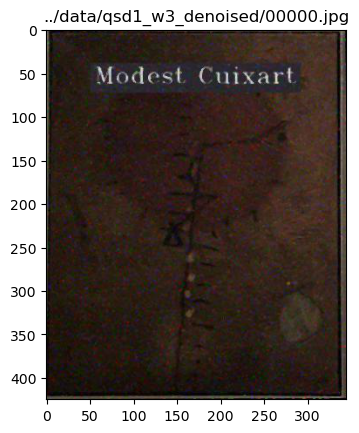

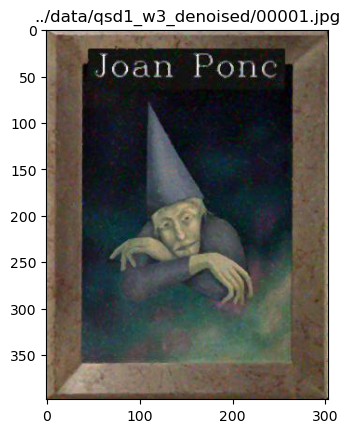

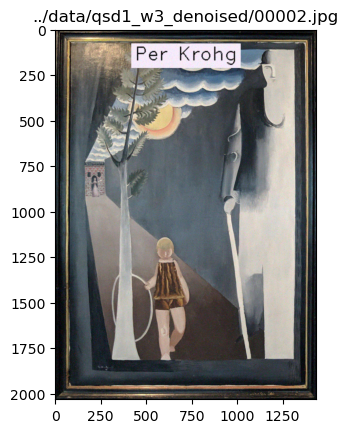

In [122]:
#Show denoised images:
for i, (img, filename) in enumerate(zip(qsd1_w3, qsd1_w3_files)):
    plt.imshow(img)
    plt.title(filename)
    plt.show()
    if i > 1:
        break

### Masks for text removal

In [123]:
# Week 2 method for text removal:
from skimage.io import imsave
# Find text bounding box.
for i, (img, filename) in enumerate(zip(qsd1_w3, qsd1_w3_files)):
    # Find text bounding box.
    bbox_pred = detect_textbox.find_text_bounding_box(qsd1_w3[i], kernel_shape = (10, 30))
    
    # Snap negative bbox detected points to origin of image (0), if needed.
    bbox_pred = [0 if c < 0 else c for c in bbox_pred]
    
    # Save predicted masks in folder.
    bbox_mask = detect_textbox.create_textbox_mask(img.shape[0:2], bbox_pred)
    mask_filename = filename[-9:]
    imsave(
        os.path.join('../results/data/w3/bbox_mask_qsd1_w3/', mask_filename),
        (255*bbox_mask).astype(np.uint8),
        check_contrast=False)

# Load bbox_masks:
masks_text_qsd1_w3, masks_text_qsd1_w3_files = data_handler.load_images(
    folder=f"../results/data/w3/bbox_mask_qsd1_w3/",
    extension=".png",
    desc=f"Loading background text masks for QSD1-W3...")

Loading background text masks for QSD1-W3...: 100%|██████████| 30/30 [00:00<00:00, 1024.73it/s]

../results/data/w3/bbox_mask_qsd1_w3/ read: 30 images


In [124]:
text_retrieval.generate_text_files(qsd1_w3, qsd1_w3_files, "../results/data/w3/text_qsd1_w3/", greys=True, binary=False)

30it [00:02, 11.99it/s]


### Method 1: Descriptors using only texture

In [125]:
# Selected texture descriptor for qsd1_w3:
print ('Selected texture descriptor: HoG')

db_texture_matrix = image_features.hog_batch(images = db[:], mssg="Histograms of Gradients (HoG) from BBDD...")
qsd1_w3_texture_matrix = image_features.hog_batch(images = qsd1_w3[:], mssg="Histograms of Gradients (HoG) from qsd1_w3...")

print (f'We have {qsd1_w3_texture_matrix.shape[0]} images, each with a {qsd1_w3_texture_matrix.shape[1]} dimensional descriptor')

Selected texture descriptor: HoG


Histograms of Gradients (HoG) from BBDD...:  14%|█▍        | 40/287 [00:02<00:09, 26.79it/s]/Users/johnny/miniconda3/envs/Team1/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:702: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
Histograms of Gradients (HoG) from qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 103.63it/s]


We have 30 images, each with a 300 dimensional descriptor


In [126]:
similarity_matrix_qsd1_w3_texture = similarities.compute_similarities_parallel(
    qsd1_w3_texture_matrix,
    db_texture_matrix,
    similarities.measures["hellinger_kernel"],
    "Computing similarities for HoG...",
    N_PROCESS,
    masks=[resize(image=mask, output_shape=(300,300)) for mask in masks_text_qsd1_w3]
)

Computing similarities for HoG...: 100%|██████████| 30/30 [00:02<00:00, 14.95it/s]


In [127]:
evaluate.get_mapk(similarity_matrix=similarity_matrix_qsd1_w3_texture, db_files=db_files,
    query_dataset="qsd1_w3", data_handler=data_handler, out_dir="../results/data/w3/combine_descriptors/texture",
)

top_1 = evaluate.get_top_k(similarity_matrix=similarity_matrix_qsd1_w3_texture, db_files=db_files,
                                         k=1, mssg="Retrieving top 1 similar images for qs1_w3...")

Retrieving top 1 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 37360.19it/s]


Results saved at ../results/data/w3/combine_descriptors/texture/qsd1_w3.pkl/result.pkl
MAP@1 Score: 93.3333% (28/30)


Retrieving top 5 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 56577.84it/s]


Results saved at ../results/data/w3/combine_descriptors/texture/qsd1_w3.pkl/result.pkl
MAP@5 Score: 94.1667% (28/30)


Retrieving top 10 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 22762.14it/s]


Results saved at ../results/data/w3/combine_descriptors/texture/qsd1_w3.pkl/result.pkl
MAP@10 Score: 94.7222% (28/30)


Retrieving top 1 similar images for qs1_w3...: 100%|██████████| 30/30 [00:00<00:00, 48714.33it/s]


Retrieving top 1 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 47554.47it/s]


Results saved at ../results/data/w3/combine_descriptors/texture/qsd1_w3.pkl/result.pkl
MAP@1 Score: 93.3333% (28/30)


Retrieving top 5 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 32606.66it/s]


Results saved at ../results/data/w3/combine_descriptors/texture/qsd1_w3.pkl/result.pkl
MAP@5 Score: 94.1667% (28/30)


Retrieving top 10 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 28866.51it/s]


Results saved at ../results/data/w3/combine_descriptors/texture/qsd1_w3.pkl/result.pkl
MAP@10 Score: 94.7222% (28/30)


Retrieving top 5 similar images for qs1_w3...: 100%|██████████| 30/30 [00:00<00:00, 35088.99it/s]


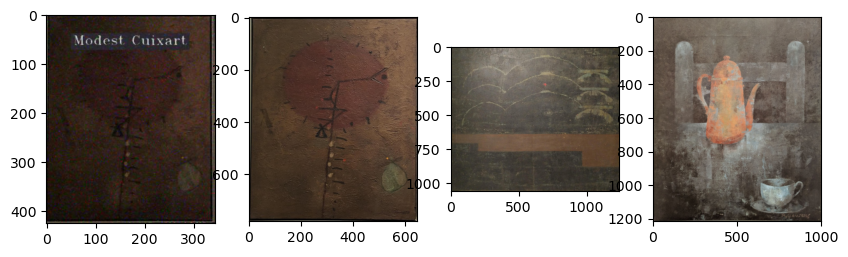

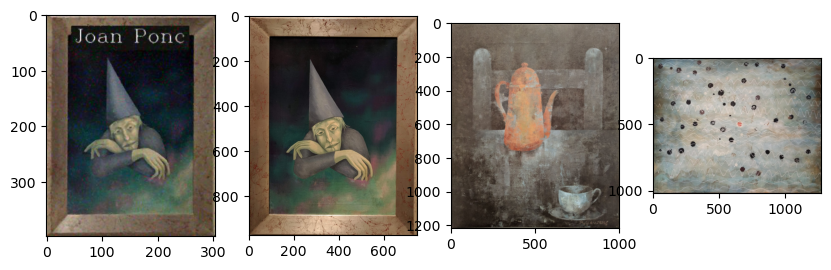

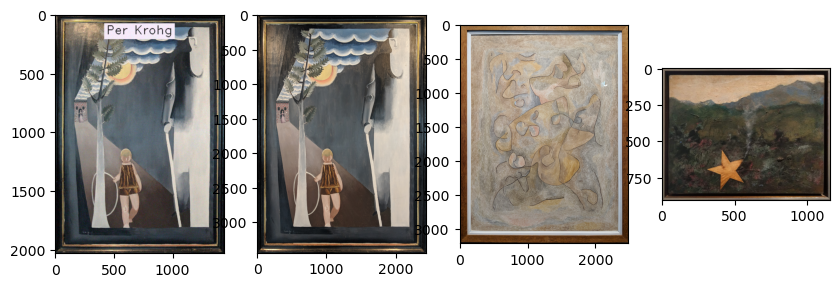

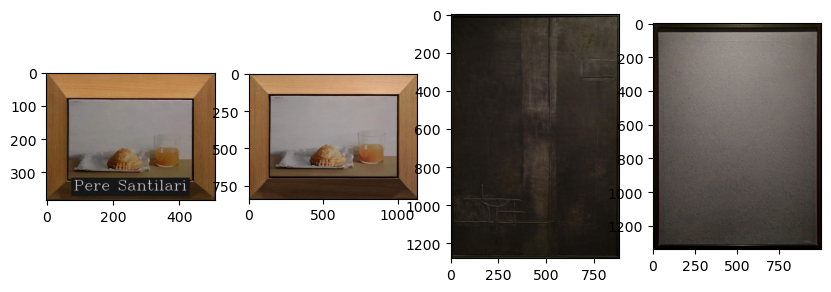

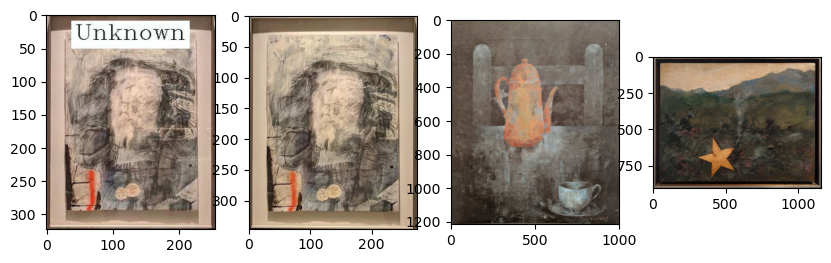

In [128]:
evaluate.get_mapk(similarity_matrix=similarity_matrix_qsd1_w3_texture, db_files=db_files,
    query_dataset="qsd1_w3", data_handler=data_handler, out_dir="../results/data/w3/combine_descriptors/texture",
)

top_5 = evaluate.get_top_k(similarity_matrix=similarity_matrix_qsd1_w3_texture, db_files=db_files,
                                         k=5, mssg="Retrieving top 5 similar images for qs1_w3...")

plot_image_and_similars(db, qsd1_w3, top_5)

### Method 2: Descriptors using only text

In [129]:
reload(text_retrieval)
pred_texts_greys_qsd1_w3_folder = './results/text/pred_texts_greys_qsd1_w3/'
text_retrieval.generate_text_files(qsd1_w3, qsd1_w3_files, pred_texts_greys_qsd1_w3_folder, greys=True)
pred_texts_greys_qsd1_w3 = data_handler.load_text(folder = pred_texts_greys_qsd1_w3_folder, extension = ".txt", desc = "Loading Predicted Text data...", tuples=False)

30it [00:02, 12.18it/s]
Loading Predicted Text data...: 100%|██████████| 30/30 [00:01<00:00, 23.46it/s]

./results/text/pred_texts_greys_qsd1_w3/ read: 30 images


Retrieving top 1 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 32930.94it/s]


Results saved at ../results/data/w3/combine_descriptors/text/qsd1_w3.pkl/result.pkl
MAP@1 Score: 26.6667% (8/30)


Retrieving top 5 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 62508.26it/s]


Results saved at ../results/data/w3/combine_descriptors/text/qsd1_w3.pkl/result.pkl
MAP@5 Score: 49.4444% (14/30)


Retrieving top 10 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 43599.83it/s]


Results saved at ../results/data/w3/combine_descriptors/text/qsd1_w3.pkl/result.pkl
MAP@10 Score: 44.1799% (13/30)


Retrieving top 1 similar images for qs1_w3...: 100%|██████████| 30/30 [00:00<00:00, 49017.97it/s]


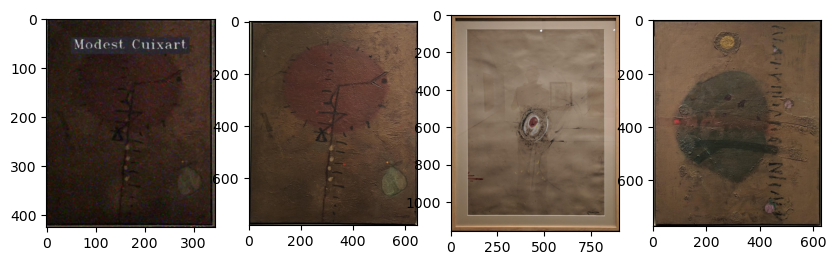

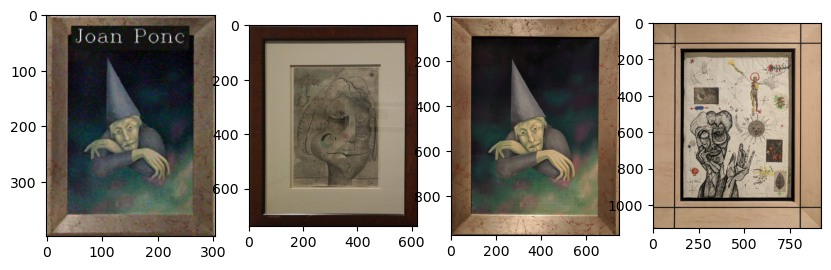

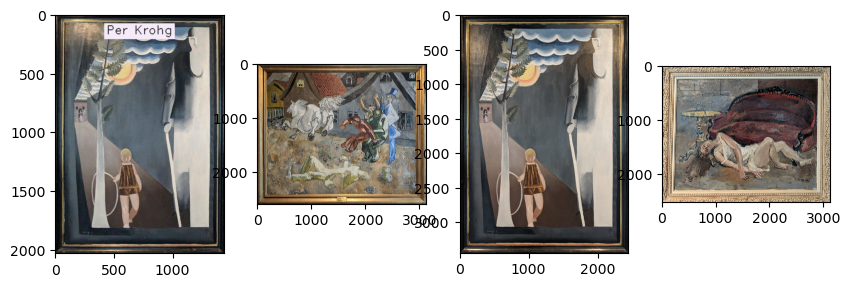

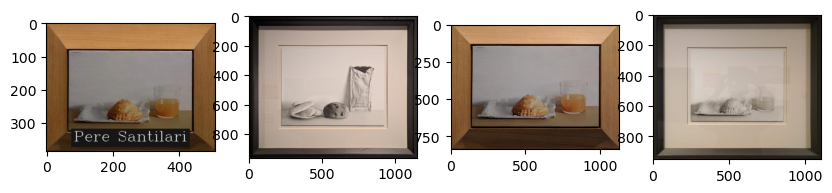

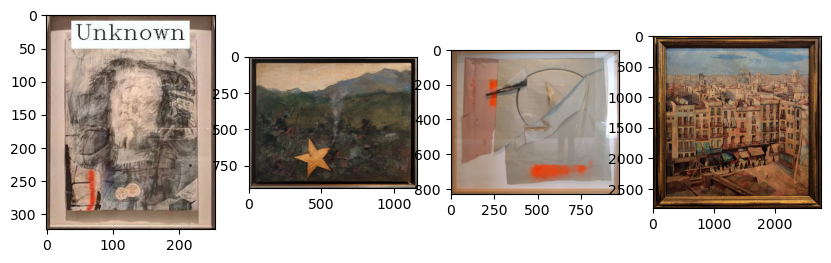

In [130]:
similarity_matrix_qsd1_w3_text = text_retrieval.get_distances_text_multiple(pred_texts_greys_qsd1_w3, db_text)
evaluate.get_mapk(similarity_matrix=similarity_matrix_qsd1_w3_text, db_files=db_files,
    query_dataset="qsd1_w3", data_handler=data_handler, out_dir="../results/data/w3/combine_descriptors/text",
)

top_5 = evaluate.get_top_k(similarity_matrix=similarity_matrix_qsd1_w3_text, db_files=db_files,
                                         k=5, mssg="Retrieving top 1 similar images for qs1_w3...")
plot_image_and_similars(db, qsd1_w3, top_5)

### Method 3: Descriptors using only color

In [131]:
# 3D Histograms Spatial pyramid representation. Parameters: Best results - Week2
similarity_matrix_qsd1_w3_color = similarities.compute_similarities_batch(
    qsd1_w3[:], db[:], 'hellinger_kernel',
    n_levels=5, n_bins=6, grayscale=False, RGB=True, CieLab=False, HSV=False, YCbCr=False, histogram3d=True,
    mssg="Computing similarities for denoised qsd1-w3...(with N_PROCESS = {})".format(N_PROCESS),
    N_PROCESS=N_PROCESS,
    masks_queries=None,
    masks_database=None,
)

Generating features for query dataset...(with N_PROCESS = 10): 100%|██████████| 30/30 [00:02<00:00, 11.89it/s]


query_features.shape (30, 82512)


Generating features for BBDD dataset...(with N_PROCESS = 10):   7%|▋         | 20/287 [00:00<00:05, 51.42it/s]/Users/johnny/miniconda3/envs/Team1/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:702: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
Generating features for BBDD dataset...(with N_PROCESS = 10): 100%|██████████| 287/287 [00:21<00:00, 13.08it/s]


db_feature_matrix.shape (287, 82512)


Computing similarities for denoised qsd1-w3...(with N_PROCESS = 10): 100%|██████████| 30/30 [00:00<00:00, 75.62it/s]


In [132]:
evaluate.get_mapk(similarity_matrix=similarity_matrix_qsd1_w3_color, db_files=db_files,
    query_dataset="qsd1_w3", data_handler=data_handler, out_dir="../results/data/w3/combine_descriptors/color/",
)

Retrieving top 1 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 55750.61it/s]


Results saved at ../results/data/w3/combine_descriptors/color//qsd1_w3.pkl/result.pkl
MAP@1 Score: 86.6667% (26/30)


Retrieving top 5 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 55236.66it/s]


Results saved at ../results/data/w3/combine_descriptors/color//qsd1_w3.pkl/result.pkl
MAP@5 Score: 87.3333% (26/30)


Retrieving top 10 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 31750.98it/s]

Results saved at ../results/data/w3/combine_descriptors/color//qsd1_w3.pkl/result.pkl
MAP@10 Score: 87.8095% (26/30)


[[1, 86.66666666666667, 26, 30],
 [5, 87.33333333333333, 26, 30],
 [10, 87.80952380952381, 26, 30]]

Retrieving top 1 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 33897.93it/s]


Results saved at ../results/data/w3/combine_descriptors/color//qsd1_w3.pkl/result.pkl
MAP@1 Score: 86.6667% (26/30)


Retrieving top 5 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 38848.14it/s]


Results saved at ../results/data/w3/combine_descriptors/color//qsd1_w3.pkl/result.pkl
MAP@5 Score: 87.3333% (26/30)


Retrieving top 10 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 43614.95it/s]


Results saved at ../results/data/w3/combine_descriptors/color//qsd1_w3.pkl/result.pkl
MAP@10 Score: 87.8095% (26/30)


Retrieving top 5 similar images for qs1_w3...: 100%|██████████| 30/30 [00:00<00:00, 28926.23it/s]


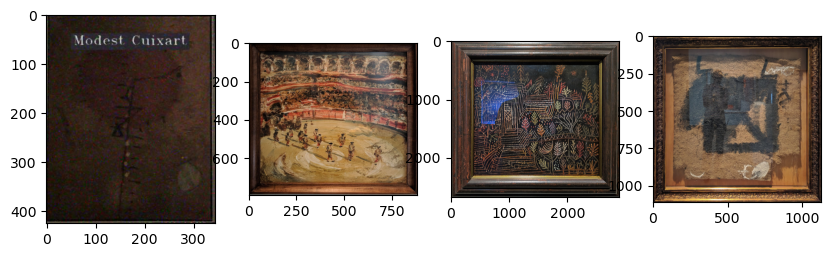

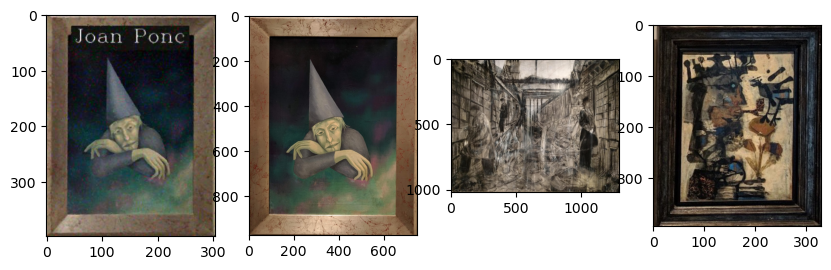

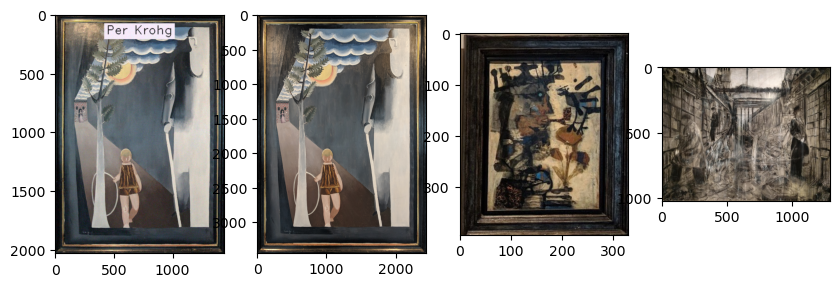

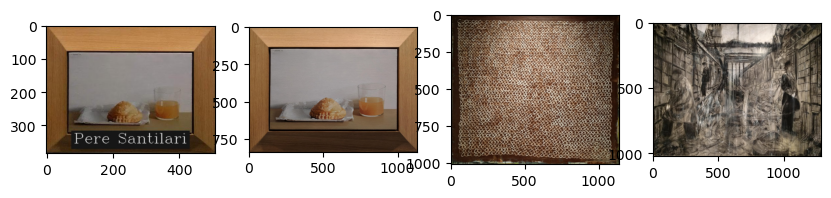

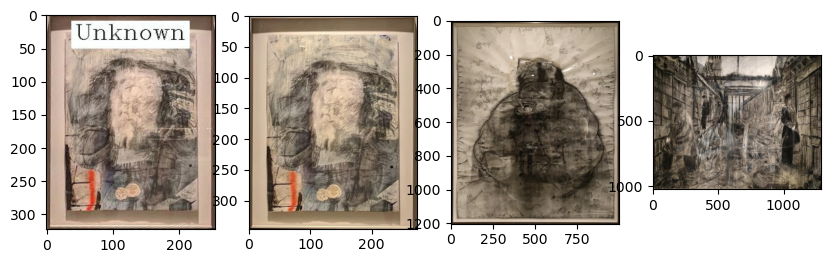

In [133]:
evaluate.get_mapk(similarity_matrix=similarity_matrix_qsd1_w3_color, db_files=db_files,
    query_dataset="qsd1_w3", data_handler=data_handler, out_dir="../results/data/w3/combine_descriptors/color/",
)

top_5 = evaluate.get_top_k(
    similarity_matrix=similarity_matrix_qsd1_w3_color, db_files=db_files,
    k=5, mssg="Retrieving top 5 similar images for qs1_w3..."
)

plot_image_and_similars(db, qsd1_w3, top_5)

## Combine descriptors

In [134]:
# Normalize distances:
texture_max = np.asarray(similarity_matrix_qsd1_w3_texture).max()
texture_min = np.asarray(similarity_matrix_qsd1_w3_texture).min()
norm_similarity_qsd1_w3_texture = (similarity_matrix_qsd1_w3_texture - texture_min) / (texture_max - texture_min)

color_max = np.asarray(similarity_matrix_qsd1_w3_color).max()
color_min = np.asarray(similarity_matrix_qsd1_w3_color).min()
norm_similarity_qsd1_w3_color = (similarity_matrix_qsd1_w3_color - color_min) / (color_max - color_min)

text_max = np.asarray(similarity_matrix_qsd1_w3_text).max()
text_min = np.asarray(similarity_matrix_qsd1_w3_text).min()
norm_similarity_qsd1_w3_text = (similarity_matrix_qsd1_w3_text - text_min) / (text_max - text_min)

### Method 4: Descriptors using the best combination of two descriptors

In [135]:
# Combining two descriptors:
color_weight = 1
texture_weight = 4

print('Color and texture descriptors')
sim_mat_qsd1_w3_2descrip = color_weight * norm_similarity_qsd1_w3_color + texture_weight * norm_similarity_qsd1_w3_texture 

Color and texture descriptors


Retrieving top 1 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 71089.90it/s]


Results saved at ../results/data/w3/combine_descriptors/2descriptors//qsd1_w3.pkl/result.pkl
MAP@1 Score: 93.3333% (28/30)


Retrieving top 5 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 32547.63it/s]


Results saved at ../results/data/w3/combine_descriptors/2descriptors//qsd1_w3.pkl/result.pkl
MAP@5 Score: 95.8333% (28/30)


Retrieving top 10 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 23293.06it/s]


Results saved at ../results/data/w3/combine_descriptors/2descriptors//qsd1_w3.pkl/result.pkl
MAP@10 Score: 95.8333% (28/30)


Retrieving top 1 similar images for qs1_w3...: 100%|██████████| 30/30 [00:00<00:00, 31702.98it/s]


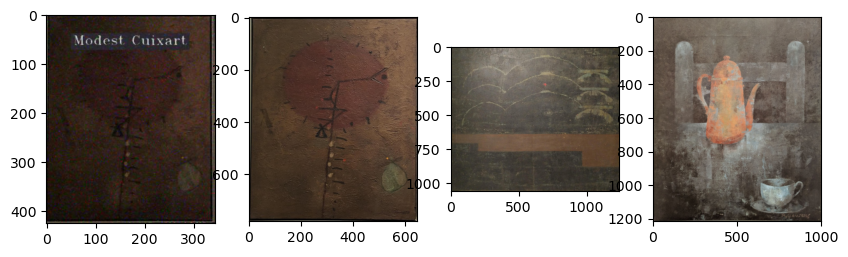

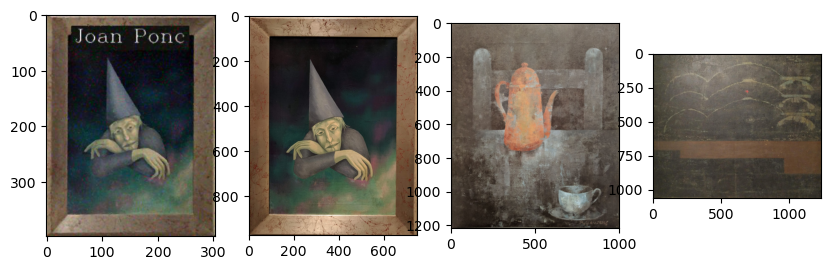

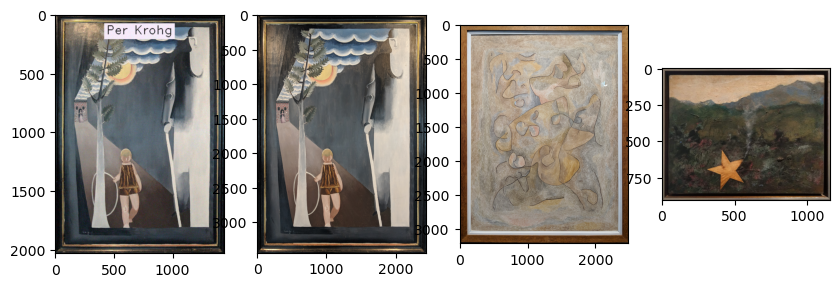

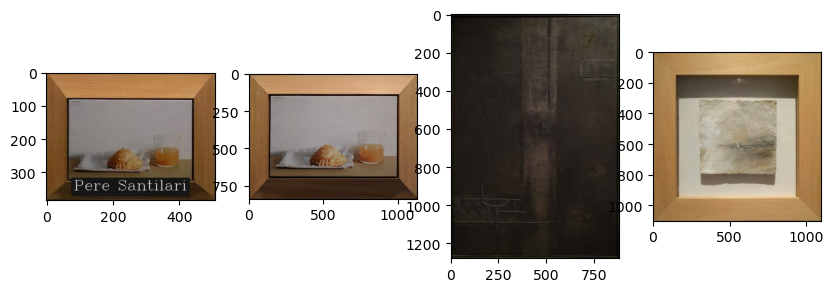

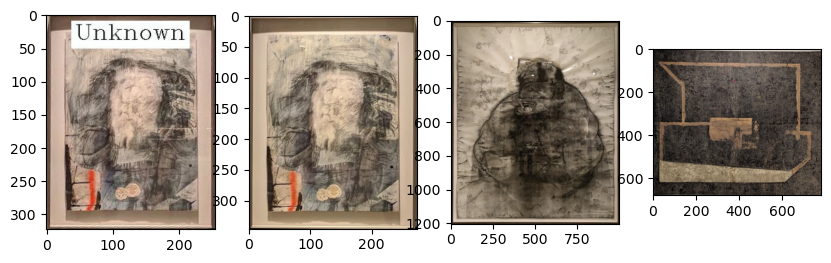

In [136]:
evaluate.get_mapk(similarity_matrix=sim_mat_qsd1_w3_2descrip, db_files=db_files,
    query_dataset="qsd1_w3", data_handler=data_handler, out_dir="../results/data/w3/combine_descriptors/2descriptors/",
)

top_5 = evaluate.get_top_k(similarity_matrix=sim_mat_qsd1_w3_2descrip, db_files=db_files,
                                         k=5, mssg="Retrieving top 1 similar images for qs1_w3...")

plot_image_and_similars(db, qsd1_w3, top_5)

### Method 5: Descriptors using the best combination of three descriptors

In [137]:
# Combining three descriptors: Color - Texture - Text
color_weight = 1
texture_weight = 4
text_weight = 1

print('Color, text and texture descriptors')
sim_mat_qsd1_w3_3descrip = color_weight * norm_similarity_qsd1_w3_color + texture_weight * norm_similarity_qsd1_w3_texture + text_weight * norm_similarity_qsd1_w3_text

Color, text and texture descriptors


Retrieving top 1 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 29475.08it/s]


Results saved at ../results/data/w3/combine_descriptors/3descriptors//qsd1_w3.pkl/result.pkl
MAP@1 Score: 100.0000% (30/30)


Retrieving top 5 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 47021.35it/s]


Results saved at ../results/data/w3/combine_descriptors/3descriptors//qsd1_w3.pkl/result.pkl
MAP@5 Score: 100.0000% (30/30)


Retrieving top 10 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 33554.43it/s]


Results saved at ../results/data/w3/combine_descriptors/3descriptors//qsd1_w3.pkl/result.pkl
MAP@10 Score: 100.0000% (30/30)


Retrieving top 5 similar images for qs1_w3...: 100%|██████████| 30/30 [00:00<00:00, 23572.33it/s]


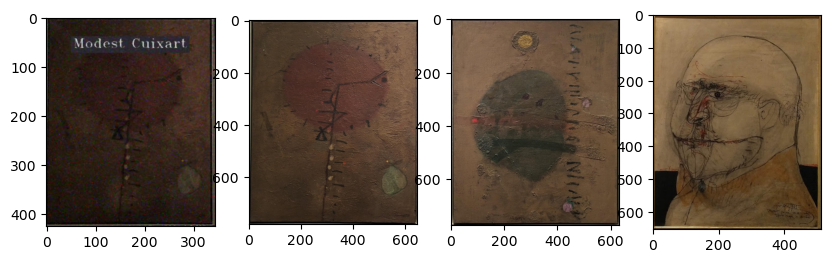

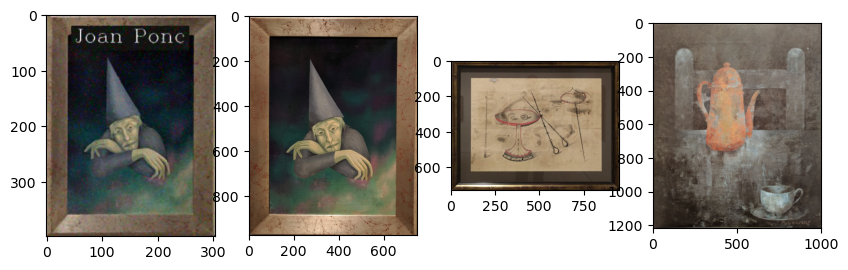

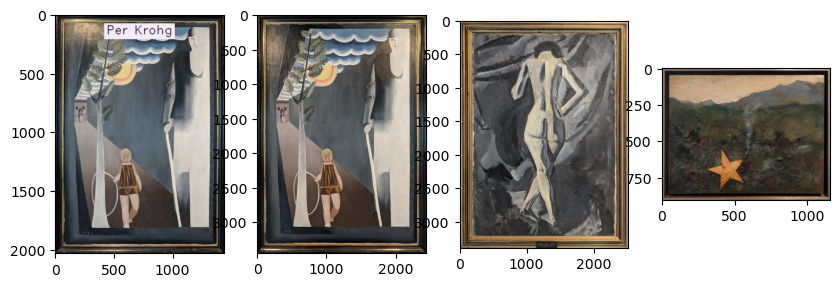

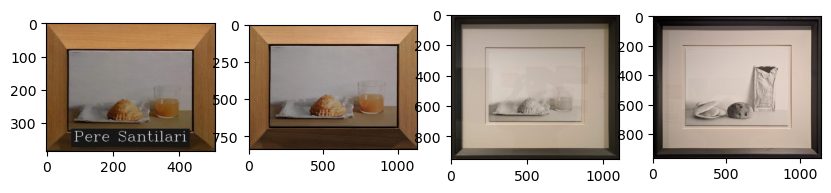

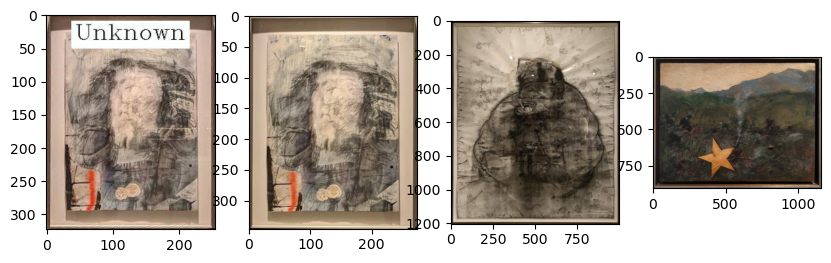

In [138]:
evaluate.get_mapk(similarity_matrix=sim_mat_qsd1_w3_3descrip, db_files=db_files,
    query_dataset="qsd1_w3", data_handler=data_handler, out_dir="../results/data/w3/combine_descriptors/3descriptors/",
)

top_5 = evaluate.get_top_k(similarity_matrix=sim_mat_qsd1_w3_3descrip, db_files=db_files,
                                         k=5, mssg="Retrieving top 5 similar images for qs1_w3...")

plot_image_and_similars(db, qsd1_w3, top_5)

Retrieving top 1 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 45116.21it/s]


Results saved at ../results/data/w3/combine_descriptors/3descriptors//qsd1_w3.pkl/result.pkl
MAP@1 Score: 100.0000% (30/30)


Retrieving top 5 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 33483.00it/s]


Results saved at ../results/data/w3/combine_descriptors/3descriptors//qsd1_w3.pkl/result.pkl
MAP@5 Score: 100.0000% (30/30)


Retrieving top 10 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 23638.76it/s]


Results saved at ../results/data/w3/combine_descriptors/3descriptors//qsd1_w3.pkl/result.pkl
MAP@10 Score: 100.0000% (30/30)


Retrieving top 10 similar images for qsd1_w3...: 100%|██████████| 30/30 [00:00<00:00, 25795.23it/s]


Results saved at ./QSD1/qsd1_w3/result.pkl


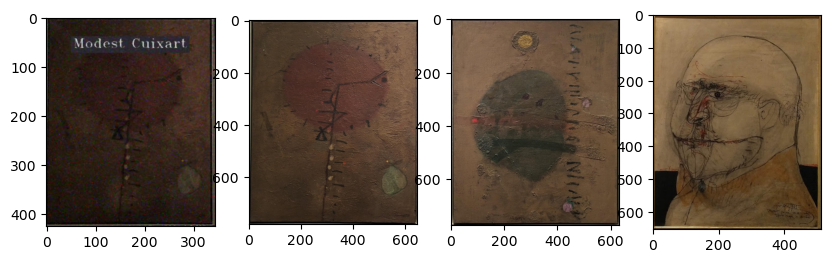

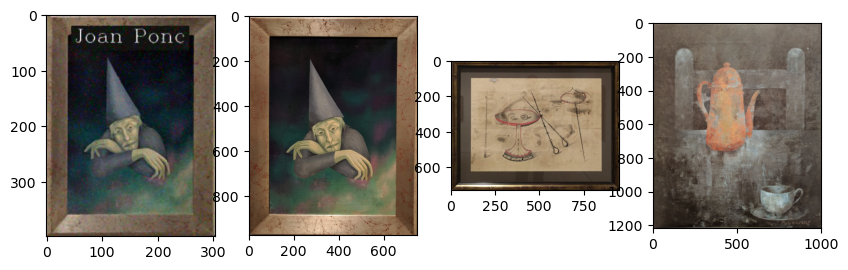

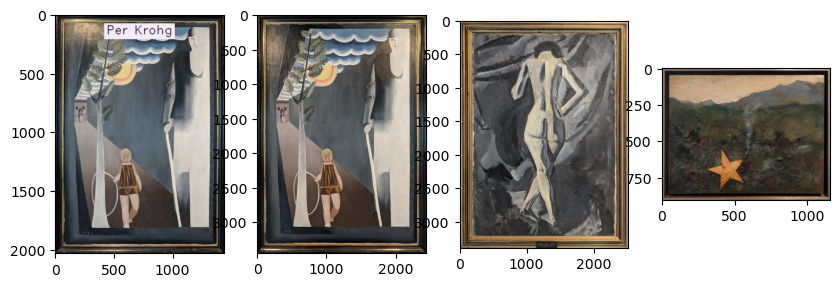

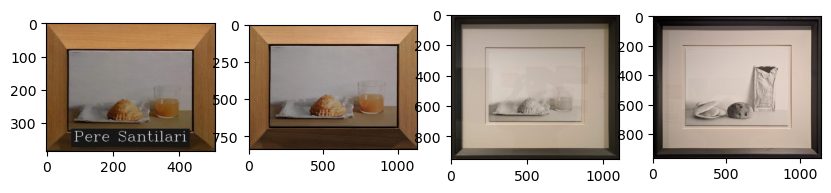

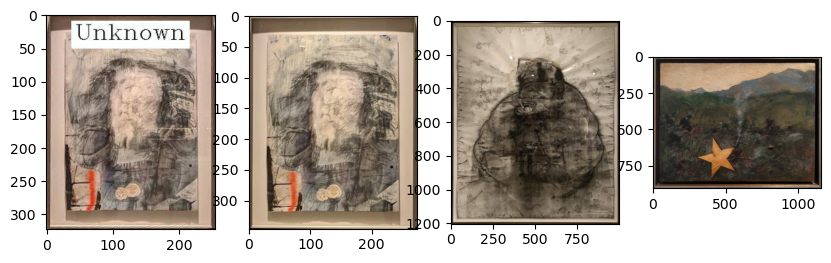

In [139]:
evaluate.get_mapk(similarity_matrix=sim_mat_qsd1_w3_3descrip, db_files=db_files,
    query_dataset="qsd1_w3", data_handler=data_handler, out_dir="../results/data/w3/combine_descriptors/3descriptors/",
)

top_10_qsd1_w3 = evaluate.get_top_k(similarity_matrix=sim_mat_qsd1_w3_3descrip, db_files=db_files,
                                    k=10, mssg="Retrieving top 10 similar images for qsd1_w3...")

predicted_results_10 = data_handler.store_outputs_single(top_10_qsd1_w3, "./QSD1/qsd1_w3", save=True)
# predicted_test1 = data_handler.store_outputs_multiple(top_10_qsd1_w3, "./QSD1/qsd1_w3/", save=True)

plot_image_and_similars(db, qsd1_w3, top_10_qsd1_w3)

## Task 5

In [140]:
# Load images:
db, db_files = data_handler.load_images(folder = "../data/BBDD/", extension = ".jpg", desc = "Loading BBDD Data...")
qsd2_w3, qsd2_w3_files = data_handler.load_images(folder = "../data/qsd2_w3_denoised/", extension = ".jpg", desc = "Loading qsd2_w3 Data...")

# Load text:
db_text = data_handler.load_text(folder = "../data/BBDD/", extension = ".txt", desc = "Loading BBDD Text data...")
qsd2_w3_text = data_handler.load_text_multiple(folder = "../data/qsd2_w3/", extension = ".txt", desc = "Loading qsd2_w3 Text data...")

Loading BBDD Data...: 100%|██████████| 287/287 [00:07<00:00, 40.09it/s]


../data/BBDD/ read: 287 images


Loading qsd2_w3 Data...: 100%|██████████| 30/30 [00:00<00:00, 107.61it/s]


../data/qsd2_w3_denoised/ read: 30 images


Loading BBDD Text data...: 100%|██████████| 287/287 [00:00<00:00, 16837.76it/s]


../data/BBDD/ read: 287 images


Loading qsd2_w3 Text data...: 100%|██████████| 30/30 [00:00<00:00, 7364.03it/s]


In [141]:
print(db_text[:3])
print()
print()
print(qsd2_w3_text[:3])

[('Victor Perez-Porros', 'Des-li-zan-tes'), ('Hugo Demarco', 'Reflecting Room'), ('', '')]


[[('Perejaume', 'El sot de la cama')], [('Pablo Picasso', 'Woman in a Chair'), ('Pablo Picasso', 'Bull Fighting')], [('Modest Cuixart', 'Simbolisme'), ('Joan Ponc', 'La lluita')]]


In [142]:
# This code generates masks for the QSD2-W3 dataset.
reload(bg_masks)
bg_masks.generate_masks_floodFill(
    qsd2_w3[:],
    two_components=True,
    N_PROCESS=N_PROCESS,
    mssg="Generating masks with floodfill method and up to two components...",
    image_files=qsd2_w3_files[:],
    output_dir='../data/floodFill_masks_qsd2_w3/',
)

Generating masks with floodfill method and up to two components...: 100%|██████████| 30/30 [00:14<00:00,  2.03it/s]


[array([[255., 255., 255., ..., 255., 255., 255.],
        [255., 255., 255., ..., 255., 255., 255.],
        [255., 255., 255., ..., 255., 255., 255.],
        ...,
        [255., 255., 255., ..., 255., 255., 255.],
        [255., 255., 255., ..., 255., 255., 255.],
        [255., 255., 255., ..., 255., 255., 255.]]),
 array([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]),
 array([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]),
 array([[255., 255., 255., ..., 255., 255., 255.],
        [255., 255., 255., ..., 255., 255., 255.],
        [255., 255., 255., ..., 255., 255., 255.],
        ...,
        [255., 

In [143]:
# load background masks
masks_gen_floodFill_qsd2_w3, masks_gen_floodFill_qsd2_w3_files = data_handler.load_images(
    folder=f"../data/floodFill_masks_qsd2_w3/",
    extension=".png",
    desc=f"Loading background masks for QSD2-W3..."
)

Loading background masks for QSD2-W3...: 100%|██████████| 30/30 [00:01<00:00, 21.03it/s]


../data/floodFill_masks_qsd2_w3/ read: 30 images


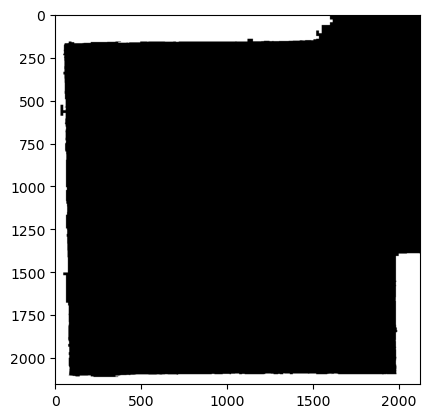

In [144]:
plt.imshow(masks_gen_floodFill_qsd2_w3[6], cmap='binary')

In [145]:
reload(image_utils)
bboxes_qsd2_w3, paintings_cropped=image_utils.crop_paintings_batch(
    qsd2_w3, qsd2_w3_files,
    masks_gen_floodFill_qsd2_w3,
    output_dir="../results/cropped_paintings_qsd2_w3/",
    extract_text_mask=True
)
data_handler.save_object_pickle(bboxes_qsd2_w3, "./QSD2/text_boxes.pkl")

Done cropping paintings.
Object saved at ./QSD2/text_boxes.pkl


In [146]:
reload(text_retrieval)
pred_texts_qsd2_w3_folder = './results/text/pred_texts_greys_qsd2_w3/'
text_retrieval.generate_text_files_multiple("../results/cropped_paintings_qsd2_w3/", pred_texts_qsd2_w3_folder, greys=True, binary=False)

### Method 1: Descriptors using only texture

In [147]:
db_texture_matrix = image_features.hog_batch(images = db[:], mssg="Histograms of Gradients (HoG) from BBDD...")
feats_multiple_qsd2_w3_texture = image_features.hog_multiple(files_dir="../results/cropped_paintings_qsd2_w3/", features_filename="qsd2_w3_hog")

Histograms of Gradients (HoG) from BBDD...:  14%|█▍        | 40/287 [00:02<00:09, 25.89it/s]/Users/johnny/miniconda3/envs/Team1/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:702: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
Histograms of Gradients (HoG) from BBDD...: 100%|██████████| 287/287 [00:24<00:00, 11.90it/s]


In [148]:
similarities_multiple_texture = similarities.compute_similarities_multiple(
    features_multiple=feats_multiple_qsd2_w3_texture,
    db_features=db_texture_matrix,
    similarity_measure="hellinger_kernel",
    n_bins=None,
)

In [149]:
top_1_multiple = evaluate.get_top_k_multiple(similarities_multiple_texture, db_files, k=1)
top_5_multiple = evaluate.get_top_k_multiple(similarities_multiple_texture, db_files, k=5)

In [150]:
predicted_results_1_qsd2_w3_multiple = data_handler.store_outputs_multiple(top_1_multiple, "./results/qsd2_w3_multiple/", save=True)
expected_results_qsd2_w3 = pickle.load(open('../data/qsd2_w3/gt_corresps.pkl', "rb"))

mapk1_qsd2_w3_multiple = evaluate.mapk_multiple(expected_results_qsd2_w3, predicted_results_1_qsd2_w3_multiple, k=1)

print("MAP@1 Score: {:.4f}% ({}/{})".format(mapk1_qsd2_w3_multiple*100,
      int(len(predicted_results_1_qsd2_w3_multiple)*mapk1_qsd2_w3_multiple), len(predicted_results_1_qsd2_w3_multiple)))

Results saved at ./results/qsd2_w3_multiple//result.pkl
MAP@1 Score: 30.5556% (9/30)


In [151]:
predicted_results_5_qsd2_w3_multiple = data_handler.store_outputs_multiple(top_5_multiple, "./results/qsd2_w3_multiple/", save=True)
expected_results_qsd2_w3 = pickle.load(open('../data/qsd2_w3/gt_corresps.pkl', "rb"))

mapk5_qsd2_w3_multiple = evaluate.mapk_multiple(expected_results_qsd2_w3, predicted_results_5_qsd2_w3_multiple, k=5)

print("MAP@5 Score: {:.4f}% ({}/{})".format(mapk5_qsd2_w3_multiple*100,
      int(len(predicted_results_5_qsd2_w3_multiple)*mapk5_qsd2_w3_multiple), len(predicted_results_5_qsd2_w3_multiple)))

Results saved at ./results/qsd2_w3_multiple//result.pkl
MAP@5 Score: 39.3519% (11/30)


### Method 2: Descriptors using only text

In [152]:
reload(text_retrieval)
similarity_multiple_qsd2_w3_text = text_retrieval.get_distances_text_2paintings(
    files_dir="../results/cropped_paintings_qsd2_w3/",
    text_database=db_text,
    dist = 'damerau_levenshtein'
)

In [153]:
top_1_multiple = evaluate.get_top_k_multiple(similarity_multiple_qsd2_w3_text, db_files, k=1)
top_5_multiple = evaluate.get_top_k_multiple(similarity_multiple_qsd2_w3_text, db_files, k=5)

In [154]:
predicted_results_1_qsd2_w3_multiple = data_handler.store_outputs_multiple(
    top_1_multiple,
    "./results/qsd2_w3_multiple/",
    save=True
)
expected_results_qsd2_w3 = pickle.load(open('../data/qsd2_w3/gt_corresps.pkl', "rb"))

mapk1_qsd2_w3_multiple = evaluate.mapk_multiple(expected_results_qsd2_w3, predicted_results_1_qsd2_w3_multiple, k=1)

print("MAP@1 Score: {:.4f}% ({}/{})".format(mapk1_qsd2_w3_multiple*100,
      int(len(predicted_results_1_qsd2_w3_multiple)*mapk1_qsd2_w3_multiple), len(predicted_results_1_qsd2_w3_multiple)))

Results saved at ./results/qsd2_w3_multiple//result.pkl
MAP@1 Score: 13.8889% (4/30)


In [155]:
predicted_results_5_qsd2_w3_multiple = data_handler.store_outputs_multiple(
    top_5_multiple,
    "./results/qsd2_w3_multiple/",
    save=True
)
expected_results_qsd2_w3 = pickle.load(open('../data/qsd2_w3/gt_corresps.pkl', "rb"))

mapk5_qsd2_w3_multiple = evaluate.mapk_multiple(expected_results_qsd2_w3, predicted_results_5_qsd2_w3_multiple, k=5)

print("MAP@5 Score: {:.4f}% ({}/{})".format(mapk5_qsd2_w3_multiple*100,
      int(len(predicted_results_5_qsd2_w3_multiple)*mapk5_qsd2_w3_multiple), len(predicted_results_5_qsd2_w3_multiple)))

Results saved at ./results/qsd2_w3_multiple//result.pkl
MAP@5 Score: 44.6296% (13/30)


### Method 3: Descriptors using only color

In [156]:
feats_multiple_qsd2_w3_color = histogram_processing.compute_features_multiple(
    "../results/cropped_paintings_qsd2_w3",
    n_levels=5, n_bins=5,
    grayscale = False, RGB = True, CieLab = False, HSV = False, YCbCr = False,
    histogram3d = True,
    use_mask = False,
)

In [157]:
reload(histogram_processing)
db_feature_matrix_color = histogram_processing.generate_feature_matrix(
    dataset=db[:],
    n_levels=5, n_bins=5,
    grayscale=False,
    RGB=True,
    CieLab=False,
    HSV=False,
    YCbCr=False,
    histogram3d=True,
    mssg="Generating features for BBDD dataset...(with N_PROCESS = {})".format(
        N_PROCESS),
    masks=None,
    N_PROCESS=N_PROCESS,
)

Generating features for BBDD dataset...(with N_PROCESS = 10):  14%|█▍        | 40/287 [00:03<00:17, 14.08it/s]/Users/johnny/miniconda3/envs/Team1/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:702: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
Generating features for BBDD dataset...(with N_PROCESS = 10): 100%|██████████| 287/287 [00:25<00:00, 11.42it/s]


In [158]:
similarities_multiple_color = similarities.compute_similarities_multiple(
    features_multiple=feats_multiple_qsd2_w3_color,
    db_features=db_feature_matrix_color,
    similarity_measure="hellinger_kernel",
    n_bins=5
)

In [159]:
top_1_multiple = evaluate.get_top_k_multiple(similarities_multiple_color, db_files, k=1)
top_5_multiple = evaluate.get_top_k_multiple(similarities_multiple_color, db_files, k=5)

In [160]:
predicted_results_1_qsd2_w3_multiple = data_handler.store_outputs_multiple(
      top_1_multiple, "./results/qsd2_w3_multiple/", save=True
)
expected_results_qsd2_w3 = pickle.load(open('../data/qsd2_w3/gt_corresps.pkl', "rb"))

mapk1_qsd2_w3_multiple = evaluate.mapk_multiple(expected_results_qsd2_w3, predicted_results_1_qsd2_w3_multiple, k=1)

print("MAP@1 Score: {:.4f}% ({}/{})".format(mapk1_qsd2_w3_multiple*100,
      int(len(predicted_results_1_qsd2_w3_multiple)*mapk1_qsd2_w3_multiple), len(predicted_results_1_qsd2_w3_multiple)))

Results saved at ./results/qsd2_w3_multiple//result.pkl
MAP@1 Score: 38.8889% (11/30)


In [161]:
predicted_results_5_qsd2_w3_multiple = data_handler.store_outputs_multiple(
      top_5_multiple, "./results/qsd2_w3_multiple/", save=True
)
expected_results_qsd2_w3 = pickle.load(open('../data/qsd2_w3/gt_corresps.pkl', "rb"))

mapk5_qsd2_w3_multiple = evaluate.mapk_multiple(expected_results_qsd2_w3, predicted_results_5_qsd2_w3_multiple, k=5)

print("MAP@5 Score: {:.4f}% ({}/{})".format(mapk5_qsd2_w3_multiple*100,
      int(len(predicted_results_5_qsd2_w3_multiple)*mapk5_qsd2_w3_multiple), len(predicted_results_5_qsd2_w3_multiple)))

Results saved at ./results/qsd2_w3_multiple//result.pkl
MAP@5 Score: 46.9907% (14/30)


## Combine descriptors

In [162]:
def get_max_multiple(list_of_lists_of_arrays):
    max_val = -99999
    for i in range(len(list_of_lists_of_arrays)):
        for j in range(len(list_of_lists_of_arrays[i])):
            max_val = np.amax([max_val, list_of_lists_of_arrays[i][j].max()])
    return max_val

def get_min_multiple(list_of_lists_of_arrays):
    min_val = 99999
    for i in range(len(list_of_lists_of_arrays)):
        for j in range(len(list_of_lists_of_arrays[i])):
            min_val = np.amin([min_val, list_of_lists_of_arrays[i][j].min()])
    return min_val

def normalize_list_of_list_of_arrays(list_of_lists_of_arrays, min, max):
    for i in range(len(list_of_lists_of_arrays)):
        for j in range(len(list_of_lists_of_arrays[i])):
            list_of_lists_of_arrays[i][j] = ( list_of_lists_of_arrays[i][j] - min ) / (max - min)
    return list_of_lists_of_arrays

def multiply_list_of_list_of_arrays(list_of_lists_of_arrays, other):
    "Multiplication is done in-place"
    for i in range(len(list_of_lists_of_arrays)):
        for j in range(len(list_of_lists_of_arrays[i])):
            list_of_lists_of_arrays[i][j] = list_of_lists_of_arrays[i][j] * other
    return list_of_lists_of_arrays

def sum_list_of_list_of_arrays(list_of_lists_of_arrays1, list_of_lists_of_arrays2):
    "Summation of list of lists of arrays"
    assert len(list_of_lists_of_arrays1) == len(list_of_lists_of_arrays2)
    res = []
    for i in range(len(list_of_lists_of_arrays1)):
        res_i = []
        for j in range(len(list_of_lists_of_arrays1[i])):
            res_i.append(list_of_lists_of_arrays1[i][j] + list_of_lists_of_arrays1[i][j])
        res.append(res_i)
    return res

In [163]:
# Normalize distances:
texture_max = get_max_multiple(similarities_multiple_texture)
texture_min = get_min_multiple(similarities_multiple_texture)
norm_similarity_qsd2_w3_texture = normalize_list_of_list_of_arrays(similarities_multiple_texture, texture_min, texture_max)

color_max = get_max_multiple(similarities_multiple_color)
color_min = get_min_multiple(similarities_multiple_color)
norm_similarity_qsd2_w3_color = normalize_list_of_list_of_arrays(similarities_multiple_color, color_min, color_max)

text_max = get_max_multiple(similarity_multiple_qsd2_w3_text)
text_min = get_min_multiple(similarity_multiple_qsd2_w3_text)
norm_similarity_qsd2_w3_text = normalize_list_of_list_of_arrays(similarity_multiple_qsd2_w3_text, text_min, text_max)

### Method 4: Descriptors using the best combination of two descriptors

In [164]:
# Combining two descriptors:
color_weight = 1
texture_weight = 4

print('Color and texture descriptors')
color_component = multiply_list_of_list_of_arrays(
    norm_similarity_qsd2_w3_color,
    color_weight,
)
texture_component = multiply_list_of_list_of_arrays(
    norm_similarity_qsd2_w3_texture,
    texture_weight,
)
# sim_mat_qsd1_w3_2descrip = color_component + texture_component
sim_mat_qsd1_w3_2descrip = sum_list_of_list_of_arrays(
    color_component, texture_component
)

Color and texture descriptors


In [165]:
top_10_multiple = evaluate.get_top_k_multiple(sim_mat_qsd1_w3_2descrip, db_files, k=10)

predicted_results_1_qsd2_w3_2descrip = data_handler.store_outputs_multiple(top_1_multiple, "./results/qsd2_w3_multiple/", save=True)
expected_results_qsd2_w3 = pickle.load(open('../data/qsd2_w3/gt_corresps.pkl', "rb"))

mapk1_qsd2_w3_2descrip = evaluate.mapk_multiple(
    expected_results_qsd2_w3, predicted_results_1_qsd2_w3_2descrip, k=1
)

print("MAP@5 Score: {:.4f}% ({}/{})".format(mapk1_qsd2_w3_2descrip*100,
      int(len(predicted_results_1_qsd2_w3_2descrip)*mapk1_qsd2_w3_2descrip),
      len(predicted_results_1_qsd2_w3_2descrip)
    )
)

top_5_multiple = evaluate.get_top_k_multiple(sim_mat_qsd1_w3_2descrip, db_files, k=5)

predicted_results_5_qsd2_w3_2descrip = data_handler.store_outputs_multiple(top_5_multiple, "./results/qsd2_w3_multiple", save=True)
expected_results_qsd2_w3 = pickle.load(open('../data/qsd2_w3/gt_corresps.pkl', "rb"))

mapk5_qsd2_w3_2descrip = evaluate.mapk_multiple(
    expected_results_qsd2_w3, predicted_results_5_qsd2_w3_2descrip, k=5
)

print("MAP@5 Score: {:.4f}% ({}/{})".format(mapk5_qsd2_w3_2descrip*100,
      int(len(predicted_results_5_qsd2_w3_2descrip)*mapk5_qsd2_w3_2descrip),
      len(predicted_results_5_qsd2_w3_2descrip)
    )
)


Results saved at ./results/qsd2_w3_multiple//result.pkl
MAP@5 Score: 38.8889% (11/30)
Results saved at ./results/qsd2_w3_multiple/result.pkl
MAP@5 Score: 46.9907% (14/30)


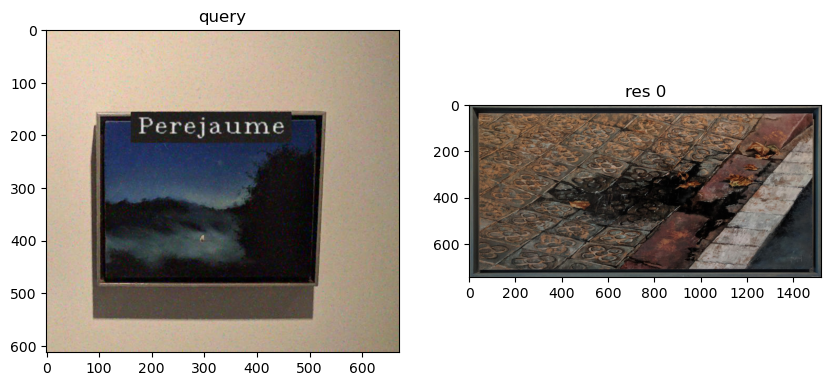

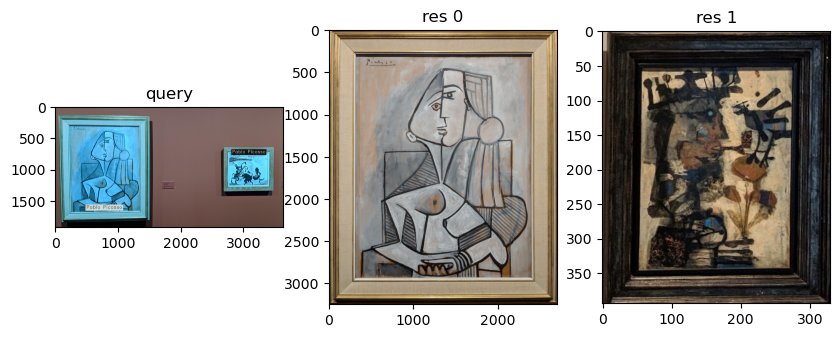

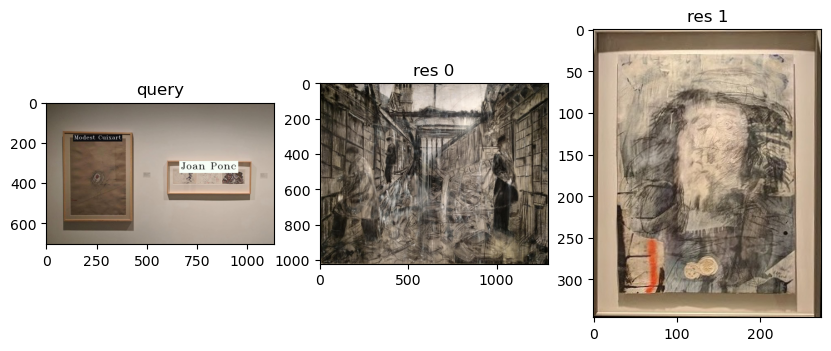

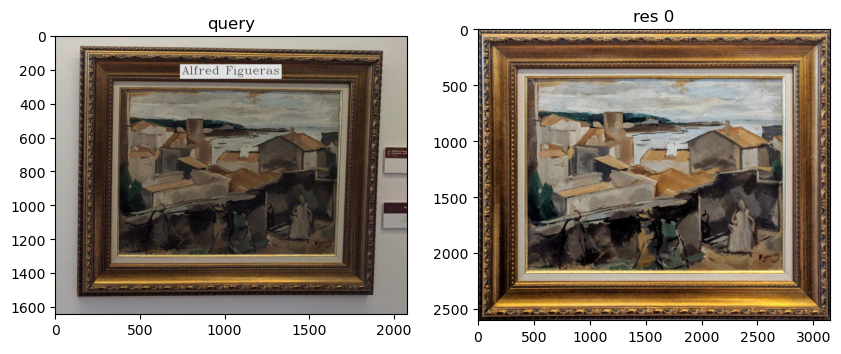

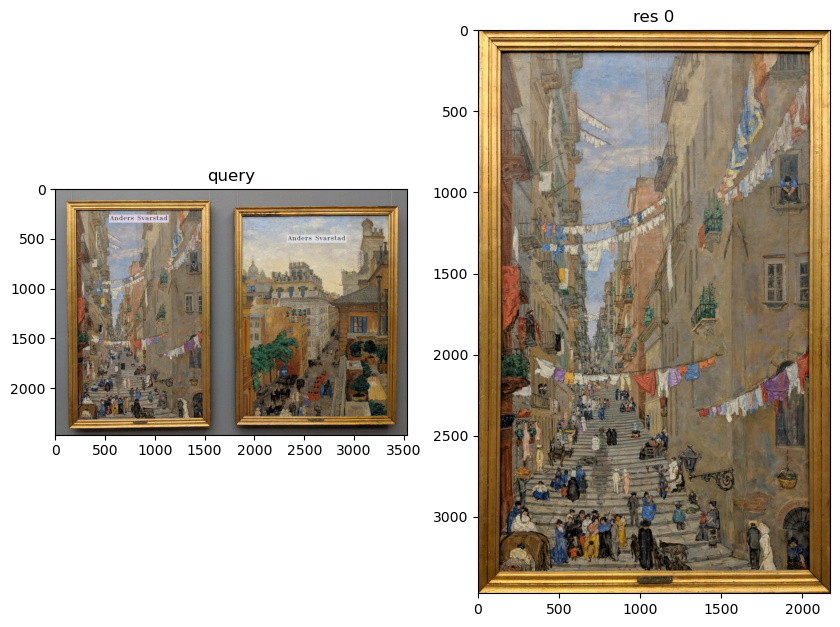

In [166]:
from skimage.io import imread

def plot_image_and_similar_multiple(qs, top_k_qs) -> None:

    for i in range(min(5, len(qs))):
        query = qs[i]

        f, axarr = plt.subplots(1, 1+len(top_k_qs[i]), figsize=(10, 10))
        axarr[0].imshow(query)
        axarr[0].title.set_text("query")
        for j in range(len(top_k_qs[i])):
            res = imread(top_k_qs[i][j][0])
            axarr[1+j].imshow(res)
            axarr[1+j].title.set_text(f"res {j}")
        plt.show()

plot_image_and_similar_multiple(qsd2_w3, top_1_multiple)


### Method 5: Descriptors using the best combination of three descriptors

In [167]:
# Combining three descriptors:
color_weight = 1
texture_weight = 1
text_weight = 1
reload(evaluate)

print('Color and texture descriptors')
color_component = multiply_list_of_list_of_arrays(
    norm_similarity_qsd2_w3_color,
    color_weight,
)
texture_component = multiply_list_of_list_of_arrays(
    norm_similarity_qsd2_w3_texture,
    texture_weight,
)
text_component = multiply_list_of_list_of_arrays(
    norm_similarity_qsd2_w3_text,
    text_weight,
)

sim_mat_qsd2_w3_3descrip_x = sum_list_of_list_of_arrays(
    color_component, texture_component
)

sim_mat_qsd2_w3_3descrip = sum_list_of_list_of_arrays(
    sim_mat_qsd2_w3_3descrip_x, text_component
)

Color and texture descriptors


In [168]:
top_1_multiple = evaluate.get_top_k_multiple(sim_mat_qsd2_w3_3descrip, db_files, k=1)

predicted_results_1_qsd2_w3_3descrip = data_handler.store_outputs_multiple(top_1_multiple, "./results/qsd2_w3_multiple/", save=True)
expected_results_qsd2_w3 = pickle.load(open('../data/qsd2_w3/gt_corresps.pkl', "rb"))

mapk1_qsd2_w3_3descrip = evaluate.mapk_multiple(
    expected_results_qsd2_w3, predicted_results_1_qsd2_w3_3descrip, k=5
)

print("MAP@5 Score: {:.4f}% ({}/{})".format(mapk1_qsd2_w3_3descrip*100,
      int(len(predicted_results_1_qsd2_w3_3descrip)*mapk1_qsd2_w3_3descrip),
      len(predicted_results_1_qsd2_w3_3descrip)
    )
)

Results saved at ./results/qsd2_w3_multiple//result.pkl
MAP@5 Score: 38.8889% (11/30)


Results saved at ./results/qsd2_w3_multiple//result.pkl
MAP@5 Score: 46.9907% (14/30)


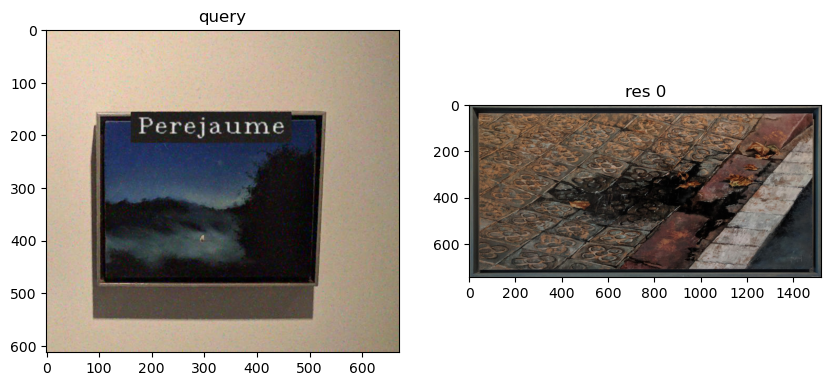

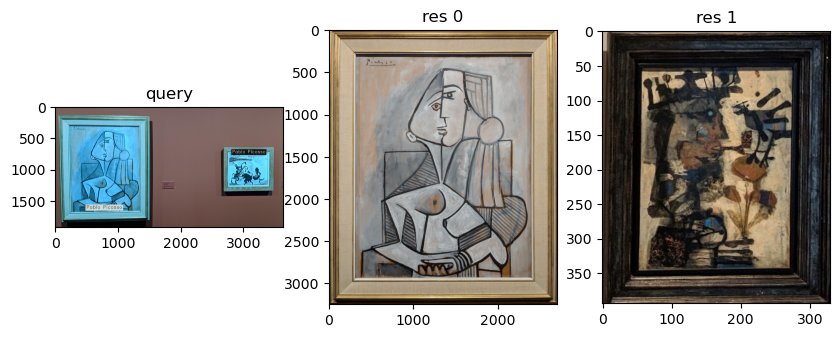

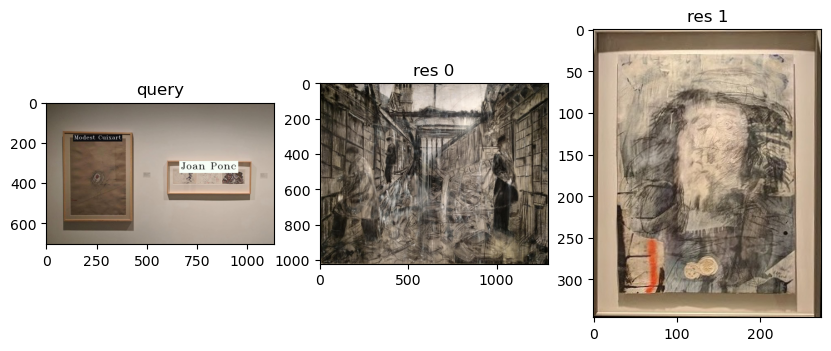

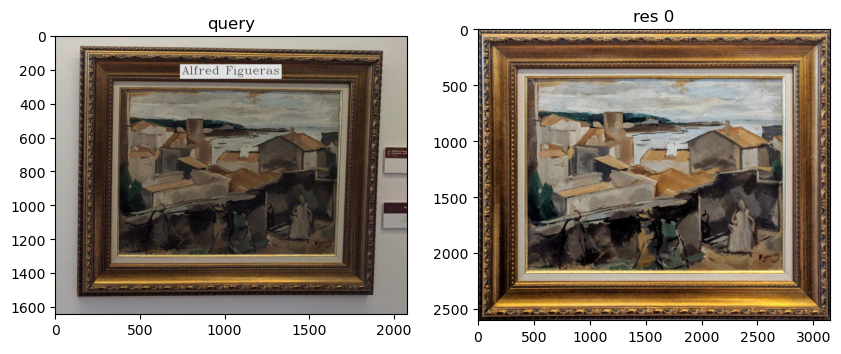

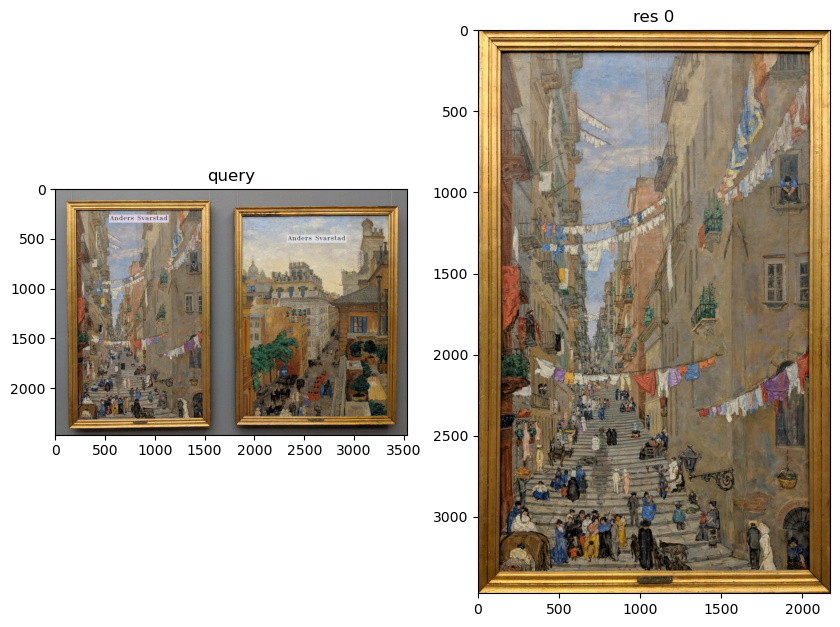

In [169]:
top_5_multiple = evaluate.get_top_k_multiple(sim_mat_qsd2_w3_3descrip, db_files, k=5)

predicted_results_5_qsd2_w3_3descrip = data_handler.store_outputs_multiple(top_5_multiple, "./results/qsd2_w3_multiple/", save=True)
expected_results_qsd2_w3 = pickle.load(open('../data/qsd2_w3/gt_corresps.pkl', "rb"))

mapk5_qsd2_w3_3descrip = evaluate.mapk_multiple(
    expected_results_qsd2_w3, predicted_results_5_qsd2_w3_3descrip, k=5
)

print("MAP@5 Score: {:.4f}% ({}/{})".format(mapk5_qsd2_w3_3descrip*100,
      int(len(predicted_results_5_qsd2_w3_3descrip)*mapk5_qsd2_w3_3descrip),
      len(predicted_results_5_qsd2_w3_3descrip)
    )
)

plot_image_and_similar_multiple(qsd2_w3, top_5_multiple)

In [170]:
top_10_multiple = evaluate.get_top_k_multiple(sim_mat_qsd2_w3_3descrip, db_files, k=10)

predicted_results_10_qsd2_w3_3descrip = data_handler.store_outputs_multiple(top_10_multiple, "./results/qsd2_w3_multiple", save=True)
expected_results_qsd2_w3 = pickle.load(open('../data/qsd2_w3/gt_corresps.pkl', "rb"))

mapk10_qsd2_w3_3descrip = evaluate.mapk_multiple(
    expected_results_qsd2_w3, predicted_results_10_qsd2_w3_3descrip, k=10
)

print("MAP@5 Score: {:.4f}% ({}/{})".format(mapk10_qsd2_w3_3descrip*100,
      int(len(predicted_results_10_qsd2_w3_3descrip)*mapk10_qsd2_w3_3descrip),
      len(predicted_results_10_qsd2_w3_3descrip)
    )
)

Results saved at ./results/qsd2_w3_multiple/result.pkl
MAP@5 Score: 48.5913% (14/30)
